# **Semantic Segmentation Using HAGDAVS Dataset**

## **Import Libraries**

In [1]:
%%capture
!pip uninstall tensorflow -y
!pip uninstall tensorflow-io -y
!pip install tensorflow
!pip install --no-deps tensorflow-io

In [2]:
import tensorflow as tf
import tensorflow_io as tfio
from tensorflow import keras
from tensorflow.keras import layers
import os
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.callbacks import TensorBoard
import pathlib
from PIL import Image
import shutil
from tensorflow.keras.layers.experimental import preprocessing

from tensorflow.data import AUTOTUNE
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

## **Load Data**

This code performs the following actions:

1. Defines directory paths for the input data, including the folder containing RGB images and the folder containing masks.
2. Sets the destination folder path to save the modified images.
3. Creates the new destination folder if it doesn't exist.
4. Retrieves the list of file names in the masks folder.
5. Iterates over each file in the list and does the following:
   - Checks if the file name contains the text "MClass".
   - If it does, modifies the file name by replacing "MClass" with "RGB".
   - Creates an old file path and a new file path.
   - Copies the old file to the new path.

In summary, the code takes masks in the "MClass" format and copies them to a new folder, but changes their names to the "RGB" format.

In [3]:
# Cargar en drive
from google.colab import drive
drive.mount('/content/drive', force_remount=True)
shared_folder_path = "/content/drive/Shareddrives/MeIA/Modulo_3_Reto"  # Reemplaza con la ruta

ModuleNotFoundError: No module named 'google.colab'

In [3]:
################################################################################
 # Kaggle (descomentar y comentar en drive)
data_dir = pathlib.Path('/kaggle/input/hagdavs/HAGDAVS')
images_dir = data_dir / 'RGB'
masks_dir = data_dir / 'MASK'

folder_path = masks_dir  # Ruta de la carpeta que contiene las imágenes
new_folder_path = '/kaggle/working/semantic-segmentation-hagdavs/HAGDAVS/MASK'

################################################################################
# Drive (descomentar y comentar en kagle)
#data_dir = pathlib.Path(f"{shared_folder_path}/HAGDAVS")
#images_dir = data_dir / 'RGB'
#masks_dir = data_dir / 'MASK'

#folder_path = masks_dir  # Ruta de la carpeta que contiene las imágenes
#new_folder_path = f"{shared_folder_path}/workingC/MASK"
################################################################################

# Crear la nueva carpeta si no existe
os.makedirs(new_folder_path, exist_ok=True)

# Obtener la lista de nombres de archivo en la carpeta
file_list = os.listdir(folder_path)

# Aplicar la modificación del nombre y crear nuevos archivos en la nueva carpeta
for filename in file_list:
    if "MClass" in filename:
        new_filename = filename.replace("MClass", "RGB")
        old_path = os.path.join(folder_path, filename)
        new_path = os.path.join(new_folder_path, new_filename)
        shutil.copy2(old_path, new_path)

## Crear copia de imágenes y máscaras ordenadas

In [4]:
import os
import shutil

################################################################################
# # Kaggle (descomentar y comentar en drive)
root_dir = "/kaggle/working/semantic-segmentation-hagdavs"
base_dir = root_dir
print(base_dir)

# Carpeta de origen
src_folder = os.path.join(base_dir, 'HAGDAVS')
################################################################################
# # Drive (descomentar y comentar en kagle)
#root_dir = shared_folder_path
#base_dir = root_dir
#print(base_dir)

# Carpeta de origen
#src_folder = os.path.join(base_dir, 'workingC')
################################################################################


# Carpeta de destino principal
dst_folder = os.path.join(src_folder, 'Prueba_aumentada')
if not os.path.exists(dst_folder):
    os.makedirs(dst_folder)

# Carpeta de destino para imágenes reales
dst_real_folder = os.path.join(dst_folder, "real_img")
if not os.path.exists(dst_real_folder):
    os.makedirs(dst_real_folder)

# Carpeta de destino para máscaras
dst_mask_folder = os.path.join(dst_folder, "mask")
if not os.path.exists(dst_mask_folder):
    os.makedirs(dst_mask_folder)

#Carpeta RGB
rgb_path = images_dir

#Carpeta Mask
mask_path = new_folder_path

#Rutas de imagenes y máscaras ordenadas
list_rgb = sorted([os.path.join(data_dir, 'RGB', i) for i in os.listdir(os.path.join(data_dir, 'RGB'))])
list_masks = sorted([os.path.join(src_folder, 'MASK', i) for i in os.listdir(os.path.join(src_folder, 'MASK'))])

names_rgb = sorted(os.listdir(os.path.join(data_dir, 'RGB')))
names_masks = sorted(os.listdir(os.path.join(src_folder, 'MASK')))

i=0
# Copiar imágenes reales a la carpeta de destino
for img_file in list_rgb:
    real_dst_path = os.path.join(dst_real_folder, names_rgb[i])
    mask_dst_path = os.path.join(dst_mask_folder, names_masks[i])
    shutil.copy2(
              list_rgb[i],
              real_dst_path
              )
    shutil.copy2(
              list_masks[i],
              mask_dst_path
              )
    i += 1

print("Listo!")

/kaggle/working/semantic-segmentation-hagdavs
Listo!


In [5]:
import os
import cv2
from tqdm import tqdm
from glob import glob
from albumentations import CenterCrop, RandomRotate90, GridDistortion, HorizontalFlip, VerticalFlip, ShiftScaleRotate, ElasticTransform, RandomBrightnessContrast, HueSaturationValue, GaussianBlur, RandomGamma, ChannelShuffle, CLAHE, RandomShadow

output_dir = os.path.join(base_dir, 'augmented_images_v2')

################################################################################
 # Kaggle (descomentar y comentar en drive)
def load_data():
     images = sorted([os.path.join(base_dir, 'HAGDAVS/Prueba_aumentada/real_img', i) for i in os.listdir(os.path.join(base_dir, 'HAGDAVS/Prueba_aumentada/real_img'))])
     masks = sorted([os.path.join(base_dir, 'HAGDAVS/Prueba_aumentada/mask', i) for i in os.listdir(os.path.join(base_dir, 'HAGDAVS/Prueba_aumentada/mask'))])
     return images, masks

################################################################################
# # Drive (descomentar y comentar en kagle)
#def load_data():
#     images = sorted([os.path.join(base_dir, 'workingC/Prueba_aumentada/real_img', i) for i in os.listdir(os.path.join(base_dir, 'workingC/Prueba_aumentada/real_img'))])
#     masks = sorted([os.path.join(base_dir, 'workingC/Prueba_aumentada/mask', i) for i in os.listdir(os.path.join(base_dir, 'workingC/Prueba_aumentada/mask'))])
#     return images, masks
################################################################################

In [6]:
def augment_data_geometric(images, masks, save_path, augment=True):
    #H = 256
    #W = 256
    
    for x, y in tqdm(zip(images, masks), total=len(images)):
        name = x.split("/")[-1].split(".")
        """ Extracting the name and extension of the image and the mask. """
        image_name = name[0]
        image_extn = name[1]

        name = y.split("/")[-1].split(".")
        mask_name = name[0]
        mask_extn = name[1]

        """ Reading image and mask. """
        x = cv2.imread(x, cv2.IMREAD_COLOR)
        y = cv2.imread(y, cv2.IMREAD_COLOR)

        """ Augmentation """
        if augment == True:
            aug = RandomRotate90(p=1.0)
            augmented = aug(image=x, mask=y)
            x1 = augmented['image']
            y1 = augmented['mask']

            #aug = GridDistortion(p=1.0)
            #augmented = aug(image=x, mask=y)
            #x2 = augmented['image']
            #y2 = augmented['mask']

            aug = HorizontalFlip(p=1.0)
            augmented = aug(image=x, mask=y)
            x3 = augmented['image']
            y3 = augmented['mask']

            aug = VerticalFlip(p=1.0)
            augmented = aug(image=x, mask=y)
            x4 = augmented['image']
            y4 = augmented['mask']

            #aug = ShiftScaleRotate(p=1.0, shift_limit=0.1, scale_limit=0.1, rotate_limit=15, border_mode=cv2.BORDER_CONSTANT)
            #augmented = aug(image=x, mask=y)
            #x5 = augmented['image']
            #y5 = augmented['mask']

            save_images = [x, x1, x3, x4]
            save_masks =  [y, y1, y3, y4]

        else:
            save_images = [x]
            save_masks = [y]

        """ Saving the image and mask. """
        idx = 0
        for i, m in zip(save_images, save_masks):
            #i = cv2.resize(i, (W, H))
            #m = cv2.resize(m, (W, H))

            if len(images) == 1:
                tmp_img_name = f"{image_name}.{image_extn}"
                tmp_mask_name = f"{mask_name}.{mask_extn}"

            else:
                tmp_img_name = f"{image_name}_{idx}.{image_extn}"
                tmp_mask_name = f"{mask_name}_{idx}.{mask_extn}"

            image_path = os.path.join(save_path, "images", tmp_img_name)
            mask_path = os.path.join(save_path, "masks", tmp_mask_name)

            cv2.imwrite(image_path, i)
            cv2.imwrite(mask_path, m)

            idx += 1

In [7]:
images, masks = load_data()

save_path = os.path.join(base_dir, 'aum_geometric')
if not os.path.exists(save_path):
    os.makedirs(save_path)
    
save_path_images = os.path.join(save_path, 'images')
if not os.path.exists(save_path_images):
    os.makedirs(save_path_images)
    
save_path_masks = os.path.join(save_path, 'masks')
if not os.path.exists(save_path_masks):
    os.makedirs(save_path_masks)
    
augment_data_geometric(images, masks, save_path, augment=True)

100%|██████████| 83/83 [01:49<00:00,  1.31s/it]


In [8]:
len(os.listdir(os.path.join(base_dir, 'aum_geometric/masks')))

332

This code performs the following actions:

1. Defines directory paths for the image and mask folders.
2. Retrieves a list of file paths for the images and masks.
3. Creates empty lists to store image and mask patches.
4. Sets the desired patch size.
5. Defines a function to load and split the images and masks into patches.
   - It reads the image and mask files.
   - Removes the alpha channel from the images and masks.
   - Divides the image into patches based on the specified patch size.
   - Checks if all pixels in a mask patch are black, and if so, skips it.
   - Appends the image and mask patches to their respective lists.
6. Applies the load_and_split_patches function to each image and mask pair.
7. Converts the lists of patches into TensorFlow tensors.
8. Creates a dataset from the image and mask patches.

In summary, the code loads image and mask files, divides them into patches of a specified size, filters out patches with all-black masks, and creates a dataset for further processing or training.

In [9]:
import tensorflow as tf
import tensorflow_io as tfio
import pathlib

################################################################################
# Kagle (descomentar y comentar en drive)
# Ruta a las carpetas de imágenes y máscaras
ima_dir = pathlib.Path('/kaggle/working/semantic-segmentation-hagdavs/aum_geometric')
images_dir = ima_dir / 'images'
m_dir = pathlib.Path('/kaggle/working/semantic-segmentation-hagdavs/aum_geometric')
mask_dir = m_dir / 'masks'

################################################################################
# Drive (descomentar y comentar en kagle)
# Ruta a las carpetas de imágenes y máscaras
#ima_dir = pathlib.Path(f"{shared_folder_path}/aum_geometric")
#images_dir = ima_dir / 'images'
#m_dir = pathlib.Path(f"{shared_folder_path}/aum_geometric")
#mask_dir = m_dir / 'masks'


# Obtener una lista de rutas de archivo para imágenes y máscaras
image_paths = sorted([str(path) for path in images_dir.glob('*.tif')])
mask_paths = sorted([str(path) for path in mask_dir.glob('*.tif')])

# Crear una lista para almacenar los parches de imágenes y máscaras
image_patches = []
mask_patches = []

# Tamaño del parche deseado
patch_size = (256, 256)


# Definir una función para cargar y dividir las imágenes y máscaras en parches
def load_and_split_patches(image_path, mask_path):
    image = tfio.experimental.image.decode_tiff(tf.io.read_file(image_path))
    mask = tfio.experimental.image.decode_tiff(tf.io.read_file(mask_path))

    # Eliminar el canal alfa de las imágenes y máscaras
    image = image[:, :, :3]
    mask = mask[:, :, :3]

    # Dividir la imagen en parches
    for i in range(0, image.shape[0], patch_size[0]):
        for j in range(0, image.shape[1], patch_size[1]):
            patch_image = image[i:i+patch_size[0], j:j+patch_size[1], :]
            patch_mask = mask[i:i+patch_size[0], j:j+patch_size[1], :]

            # Verificar si todos los píxeles en el parche de la máscara son negros
            if tf.reduce_all(tf.math.equal(patch_mask, [0, 0, 0])):
                continue
                
            #patch_mask = convertir_colores(patch_mask)
            image_patches.append(patch_image)
            mask_patches.append(patch_mask)

    return None

# Aplicar la función de carga y división de parches a cada par de rutas de archivo
for image_path, mask_path in zip(image_paths, mask_paths):
    load_and_split_patches(image_path, mask_path)

# Convertir las listas de parches en tensores
image_patches = tf.convert_to_tensor(image_patches)
mask_patches = tf.convert_to_tensor(mask_patches)

# Crear un dataset a partir de los parches de imágenes y máscaras
dataset = tf.data.Dataset.from_tensor_slices((image_patches, mask_patches))

The size of images in dataset:

In [10]:
dataset

<_TensorSliceDataset element_spec=(TensorSpec(shape=(256, 256, 3), dtype=tf.uint8, name=None), TensorSpec(shape=(256, 256, 3), dtype=tf.uint8, name=None))>

## **Display Data**

Function for show the image, mask and prediction mask

In [11]:
def display(display_list):
  plt.figure(figsize=(15, 15))

  title = ["Input Image", "True Mask", "Predicted Mask"]

  for i in range(len(display_list)):
    plt.subplot(1, len(display_list), i+1)
    plt.title(title[i])
    plt.imshow(tf.keras.utils.array_to_img(display_list[i]))
    plt.axis("off")
  plt.show()

## **Using only one class**

This code defines a function called `convertir_mascara` and applies it to a dataset using the `map` function.

The `convertir_mascara` function performs the following actions:

1. Casts the input mask tensor to `float32` data type.
2. Creates a new mask tensor filled with zeros, with dimensions `(256, 256, 1)`.
3. Assigns values corresponding to each class in the mask:
   - If all RGB values in the mask are `[0, 0, 0]`, assigns `0.0` to the corresponding pixel in the converted mask.
   - If all RGB values are `[255, 0, 0]`, assigns `0.0`.
   - If all RGB values are `[0, 255, 0]`, assigns `1.0`.
   - If all RGB values are `[0, 0, 255]`, assigns `0.0`.
4. Returns the converted mask.

The code then applies the `convertir_mascara` function to each element in the `dataset` using the `map` function. The `map` function takes a lambda function that applies the conversion function to each `(image, mask)` pair in the dataset, resulting in a new dataset named `mapped_dataset`. The images in the dataset remain unchanged, while the masks are converted using the `convertir_mascara` function.

In [12]:
def convertir_mascara(mascara):
    mascara = tf.cast(mascara, dtype=tf.float32)
    mascara_convertida = tf.zeros((256, 256, 1), dtype=tf.float32)

    # Asigna valores correspondientes a cada clase
    mascara_convertida = tf.where(tf.reduce_all(tf.equal(mascara, [0, 0, 0]), axis=-1, keepdims=True), 0.0, mascara_convertida)
    mascara_convertida = tf.where(tf.reduce_all(tf.equal(mascara, [255, 0, 0]), axis=-1, keepdims=True), 0.0, mascara_convertida)
    mascara_convertida = tf.where(tf.reduce_all(tf.equal(mascara, [0, 255, 0]), axis=-1, keepdims=True), 1.0, mascara_convertida)
    mascara_convertida = tf.where(tf.reduce_all(tf.equal(mascara, [0, 0, 255]), axis=-1, keepdims=True), 0.0, mascara_convertida)

    return mascara_convertida

mapped_dataset = dataset.map(lambda x, y: (x, convertir_mascara(y)))

This code defines a function called `filter_func` that filters the `mapped_dataset` based on certain criteria using the `filter` function.

The `filter_func` function performs the following actions:

1. Reshapes the mask tensor into a 1-dimensional tensor.
2. Uses `tf.unique` to obtain the unique classes present in the mask.
3. Checks if the number of unique classes (`tf.size(unique_classes)`) is greater than or equal to 2.
   - If there are two or more unique classes, it returns `True`, indicating that the image and mask pair should be included in the filtered dataset.
   - If there are fewer than two unique classes, it returns `False`, indicating that the image and mask pair should be filtered out.

The code then applies the `filter_func` function to each element in the `mapped_dataset` using the `filter` function. The `filter` function takes the lambda function `filter_func` as an argument and returns a new dataset named `filtered_dataset` that contains only the image and mask pairs that satisfy the filtering criteria.

In [13]:
import tensorflow as tf

def filter_func(image, mask):
    unique_classes = tf.unique(tf.reshape(mask, [-1]))[0]
    return tf.size(unique_classes) >= 2

filtered_dataset = mapped_dataset.filter(filter_func)

dataset_length = 0
for _ in filtered_dataset:
    dataset_length += 1

print("Longitud aproximada del dataset filtrado:", dataset_length)

Longitud aproximada del dataset filtrado: 4172


## **Splitting data**

train/test/val split

In [14]:
# dividir el dataset en conjuntos de entrenamiento, validación y prueba
total_samples = (dataset_length)
train_size = int(0.7 * total_samples)
val_size = int(0.15 * total_samples)
test_size = total_samples - train_size - val_size

train_dataset = filtered_dataset.take(train_size)
val_dataset = filtered_dataset.skip(train_size).take(val_size)
test_dataset = filtered_dataset.skip(train_size + val_size).take(test_size)

In [15]:
BATCH_SIZE = 16
BUFFER_SIZE = 100

In [16]:
train_batches = train_dataset.cache().shuffle(BUFFER_SIZE).batch(BATCH_SIZE).repeat()
train_batches = train_batches.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)
validation_batches = test_dataset.batch(BATCH_SIZE)
test_batches = test_dataset.batch(BATCH_SIZE)

## **Unet**

In [17]:
# Se cambió la función de activación relu por LeakyReLU dado que daba mejores resultados
# Funcion normal con maximo de 1024 neuronas
# Nota: solo correr una red

def double_conv_block(x, n_filters):

    # Conv2D then ReLU activation
    x = layers.Conv2D(n_filters, 3, padding = "same", kernel_initializer = "he_normal")(x)
    x = layers.BatchNormalization()(x)
    x = layers.Activation("LeakyReLU")(x)
    # Conv2D then ReLU activation
    x = layers.Conv2D(n_filters, 3, padding = "same", kernel_initializer = "he_normal")(x)
    x = layers.BatchNormalization()(x)
    x = layers.Activation("LeakyReLU")(x)
    # Conv2D then ReLU activation
    x = layers.Conv2D(n_filters, 3, padding = "same", kernel_initializer = "he_normal")(x)
    x = layers.BatchNormalization()(x)
    x = layers.Activation("LeakyReLU")(x)
    # dropout
    x = layers.Dropout(0.2)(x)

    return x

def downsample_block(x, n_filters):
    f = double_conv_block(x, n_filters)
    p = layers.MaxPool2D(2)(f)
    p = layers.Dropout(0.2)(p)

    return f, p

def upsample_block(x, conv_features, n_filters):
    # upsample
    x = layers.Conv2DTranspose(n_filters, 3, 2, padding="same")(x)
    # concatenate
    x = layers.concatenate([x, conv_features])
    # dropout
    x = layers.Dropout(0.2)(x)
    # Conv2D twice with ReLU activation
    x = double_conv_block(x, n_filters)

    return x

def build_unet_model():

    # inputs
    inputs = layers.Input(shape=(256,256,3))

    # encoder: contracting path - downsample
    # 1 - downsample
    f1, p1 = downsample_block(inputs, 64)
    # 2 - downsample
    f2, p2 = downsample_block(p1, 128)
    # 3 - downsample
    f3, p3 = downsample_block(p2, 256)
    # 4 - downsample
    f4, p4 = downsample_block(p3, 512)

    # 5 - bottleneck
    bottleneck = double_conv_block(p4, 1024)
    bottleneck = layers.Dropout(0.3)(bottleneck)

    # decoder: expanding path - upsample
    # 6 - upsample
    u6 = upsample_block(bottleneck, f4, 512)
    # 7 - upsample
    u7 = upsample_block(u6, f3, 256)
    # 8 - upsample
    u8 = upsample_block(u7, f2, 128)
    # 9 - upsample
    u9 = upsample_block(u8, f1, 64)

    # outputs
    outputs = layers.Conv2D(1, 1, padding="same", activation = "sigmoid")(u9)

    # unet model with Keras Functional API
    unet_model = tf.keras.Model(inputs, outputs, name="U-Net")

    return unet_model

unet_model = build_unet_model()

#Función de pérdida para clasificación binaria: BinaryFocalCrossentropy

BFC = tf.keras.losses.BinaryFocalCrossentropy(
    apply_class_balancing=True,   #Balanceo de datos
    alpha=0.25,   #Parámetro de peso
    gamma=2.0,    #Focussing parameter
    from_logits=False,   #False para datos con función sigmoide en la última capa
    label_smoothing=0.0,
    axis=-1,
    reduction=tf.keras.losses.Reduction.AUTO, #AUTO según el modelo
    )

#loss = keras.losses.sparse_categorical_crossentropy()

unet_model.compile(optimizer=tf.keras.optimizers.Adam(),
                   loss=BFC,
                   metrics=["accuracy"])

## **Unet Extendida 2048 Neuronas**

En la segunda red se muestra una red más amplia con un máximo de 2048 neuronas.
Existe una desventaja al utilizar una red más grande, debido a que se está trabajando en un entorno colaborativo como lo es 'Google Colab' y 'Kaggle'; la limitación de recursos es importante considerar. Teniendo en cuenta esta limitación se opto por utilizar la primera opción.

In [ ]:
# Se cambió la función de activación relu por LeakyReLU dado que daba mejores resultados, agregue un parametro alpha
# Funcion con modelo + una capa con maximo de 2048 neuronas
# Nota: solo correr una red

import numpy as np
from sklearn.model_selection import KFold, cross_val_score
from tensorflow.keras.wrappers.scikit_learn import KerasClassifier

def double_conv_block(x, n_filters):
    # Conv2D then LeakyReLU
    x = layers.Conv2D(n_filters, 3, padding="same", kernel_initializer="he_normal")(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(alpha=0.2)(x)
    # Conv2D then LeakyReLU
    x = layers.Conv2D(n_filters, 3, padding="same", kernel_initializer="he_normal")(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(alpha=0.2)(x)
    # Conv2D then LeakyReLU
    x = layers.Conv2D(n_filters, 3, padding="same", kernel_initializer="he_normal")(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(alpha=0.2)(x)
    # dropout
    x = layers.Dropout(0.2)(x)

    return x

def downsample_block(x, n_filters):
    f = double_conv_block(x, n_filters)
    p = layers.MaxPool2D(2)(f)
    p = layers.Dropout(0.2)(p)

    return f, p

def upsample_block(x, conv_features, n_filters):
    # upsample
    x = layers.Conv2DTranspose(n_filters, 3, 2, padding="same")(x)
    # concatenate
    x = layers.concatenate([x, conv_features])
    # dropout
    x = layers.Dropout(0.2)(x)
    # Conv2D twice with ReLU activation
    x = double_conv_block(x, n_filters)

    return x

def build_unet_model():

    # inputs
    inputs = layers.Input(shape=(256,256,3))
    # encoder: contracting path - downsample
    # 1 - downsample
    f1, p1 = downsample_block(inputs, 64)
    # 2 - downsample
    f2, p2 = downsample_block(p1, 128)
    # 3 - downsample
    f3, p3 = downsample_block(p2, 256)
    # 4 - downsample
    f4, p4 = downsample_block(p3, 512)
    # 5 - downsample
    f5, p5 = downsample_block(p4, 1024)

    # 6 - bottleneck
    bottleneck = double_conv_block(p5, 2048)
    bottleneck = layers.Dropout(0.2)(bottleneck)

    # decoder: expanding path - upsample
    # 7 - upsample
    u7 = upsample_block(bottleneck, f5, 1024)
    # 8 - upsample
    u8 = upsample_block(u7, f4, 512)
    # 9 - upsample
    u9 = upsample_block(u8, f3, 256)
    # 10 - upsample
    u10 = upsample_block(u9, f2, 128)
    # 11 - upsample
    u11 = upsample_block(u10, f1, 64)

    # outputs
    outputs = layers.Conv2D(1, 1, padding="same", activation = "sigmoid")(u11)

    # unet model with Keras Functional API
    unet_model = tf.keras.Model(inputs, outputs, name="U-Net")

    return unet_model

unet_model = build_unet_model()

#Función de pérdida para clasificación binaria: BinaryFocalCrossentropy

BFC = tf.keras.losses.BinaryFocalCrossentropy(
    apply_class_balancing=True,   #Balanceo de datos
    alpha=0.25,   #Parámetro de peso
    gamma=2.0,    #Focussing parameter
    from_logits=False,   #False para datos con función sigmoide en la última capa
    label_smoothing=0.0,
    axis=-1,
    reduction=tf.keras.losses.Reduction.AUTO, #AUTO según el modelo
    )

#loss = keras.losses.sparse_categorical_crossentropy()

################################################################################
# # Adam - El mejor de los 3
unet_model.compile(optimizer=tf.keras.optimizers.Adam(),
                   loss=BFC,
                   metrics=["accuracy"])
################################################################################
# # SGD - El peor de los 3
# optimizer = tf.keras.optimizers.SGD(learning_rate=0.01, momentum=0.9)

# unet_model.compile(optimizer=optimizer,
#                     loss='binary_crossentropy',
#                     metrics=["accuracy"])
################################################################################
# # RMSprop
# optimizer = tf.keras.optimizers.RMSprop(learning_rate=0.001, rho=0.9)

# unet_model.compile(optimizer=optimizer,
#                     loss='binary_crossentropy',
#                     metrics=["accuracy"])
################################################################################

## **Cómo evitar el Overfitting?**

Se planteó utilizar diferentes optimizadores para mejorar el rendimiento del programa, aquí algunas de las opciones que se utilizaron:

1.   Adam: Adam es un optimizador popular que combina las ventajas del optimizador RMSprop.Es adecuado para una amplia gama de problemas y tiende a funcionar bien en la mayoría de los casos.
2.   RMSprop: RMSprop es un optimizador que ajusta las tasas de aprendizaje de forma adaptativa para cada parámetro. Es útil en problemas con gradientes dispersos.
3. SGD: SGD es un optimizador básico que actualiza los parámetros en función del gradiente de la función de pérdida. Aunque es simple, a menudo se necesita un ajuste cuidadoso de la tasa de aprendizaje para obtener buenos resultados.

## **Regularizadores y Dropout**

La efectividad del dropout en comparación con los regularizadores como L1 o L2 puede variar dependiendo del problema, el modelo y los datos específicos. Sin embargo, hay algunas razones por las que el dropout puede funcionar mejor en ciertos casos:

*   Regularización estocástica: El dropout es una forma de regularización estocástica. Durante el entrenamiento, el dropout "apaga" aleatoriamente un conjunto de unidades (neuronas) en cada paso de entrenamiento, lo que hace que la red sea más robusta y evita que se vuelva demasiado dependiente de un subconjunto específico de características o conexiones. Esto puede ayudar a evitar el sobreajuste y mejorar la generalización del modelo.

*   Flexibilidad en la asignación de recursos: El dropout permite que las unidades de la red se adapten de manera más flexible y dinámica durante el entrenamiento, ya que no pueden confiar en la presencia constante de otras unidades. Esto puede ayudar a evitar la coadaptación de características y promover una representación más diversa y generalizable.

*   Menor necesidad de ajuste de hiperparámetros: El dropout tiene un hiperparámetro principal, la tasa de dropout, que controla la probabilidad de "apagar" una unidad. Sin embargo, en general, el dropout es menos sensible a la elección precisa de la tasa de dropout en comparación con los regularizadores L1 o L2. Esto puede hacer que el ajuste de hiperparámetros sea más sencillo y menos propenso a errores.


## **Training**

In [18]:
keras.backend.clear_session()
NUM_EPOCHS = 10
PATIENCE = NUM_EPOCHS//2 # Stop if not improve in PATIENCE epoch
BATCH_SIZE = 16

# To callbacks
# Save in filepath_best_model the best model according with validation accuracy
# and stop after patience epoch if this do not improve.
# Path best model in kaggle
filepath_best_model = '/kaggle/working/semantic-segmentation-hagdavs/weights.best.hdf5'
# Path best model in Colab
#filepath_best_model = f'{shared_folder_path}/weights.best.hdf5'
checkpoint = ModelCheckpoint(filepath_best_model, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')
es = EarlyStopping(monitor='val_accuracy', patience=PATIENCE)
callbacks_list = [checkpoint, es]

STEPS_PER_EPOCH = total_samples // BATCH_SIZE

VAL_SUBSPLITS = 5
VALIDATION_STEPS = test_size // BATCH_SIZE // VAL_SUBSPLITS

model_history = unet_model.fit(train_batches,
                               callbacks=callbacks_list,
                               epochs=NUM_EPOCHS,
                               steps_per_epoch=STEPS_PER_EPOCH,
                               validation_steps=VALIDATION_STEPS,
                               validation_data=validation_batches,)

Epoch 1/10


2023-06-29 22:01:43.788742: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inU-Net/dropout/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


260/260 [==============================] - ETA: 0s - loss: 0.0179 - accuracy: 0.9565
Epoch 1: val_accuracy improved from -inf to 0.96120, saving model to /kaggle/working/semantic-segmentation-hagdavs/weights.best.hdf5
260/260 [==============================] - 562s 2s/step - loss: 0.0179 - accuracy: 0.9565 - val_loss: 0.0103 - val_accuracy: 0.9612
Epoch 2/10
260/260 [==============================] - ETA: 0s - loss: 0.0089 - accuracy: 0.9652
Epoch 2: val_accuracy did not improve from 0.96120
260/260 [==============================] - 500s 2s/step - loss: 0.0089 - accuracy: 0.9652 - val_loss: 0.1448 - val_accuracy: 0.8872
Epoch 3/10
260/260 [==============================] - ETA: 0s - loss: 0.0077 - accuracy: 0.9699
Epoch 3: val_accuracy did not improve from 0.96120
260/260 [==============================] - 490s 2s/step - loss: 0.0077 - accuracy: 0.9699 - val_loss: 0.0618 - val_accuracy: 0.8886
Epoch 4/10
260/260 [==============================] - ETA: 0s - loss: 0.0072 - accuracy: 0.9

## Load Model

In [19]:
# Create a basic model instance
model_loaded = build_unet_model()

# Loads the weights
model_loaded.load_weights(filepath_best_model)

## Descarga de archivos de salida

In [6]:
import os
import subprocess
from IPython.display import FileLink, display

def download_file(path, download_file_name):
    os.chdir('/kaggle/working/')
    zip_name = f"/kaggle/working/{download_file_name}.zip"
    command = f"zip {zip_name} {path} -r"
    result = subprocess.run(command, shell=True, capture_output=True, text=True)
    if result.returncode != 0:
        print("Unable to run zip command!")
        print(result.stderr)
        return
    display(FileLink(f'{download_file_name}.zip'))

In [11]:
download_file('/kaggle/working/','out')

/kaggle/working/out.zip

## **Visualization of predictions**

In [20]:
def create_mask(pred_mask, threshold):
  pred_mask = tf.cast(pred_mask, dtype=tf.float32)  # convertir a float
  pred_mask = tf.where(pred_mask > threshold, 1.0, 0.0)  # usar float para el threshold
  return pred_mask[0]

def show_predictions(dataset, model, num, threshold=0.2):
  if dataset:
    for image, mask in dataset.take(num):
      pred_mask = model.predict(image)
      display([image[0], mask[0], create_mask(pred_mask,threshold)])
  else:
    display([sample_image, sample_mask,
             create_mask(model.predict(sample_image[tf.newaxis, ...]))])

1/1 [==============================] - 0s 35ms/step


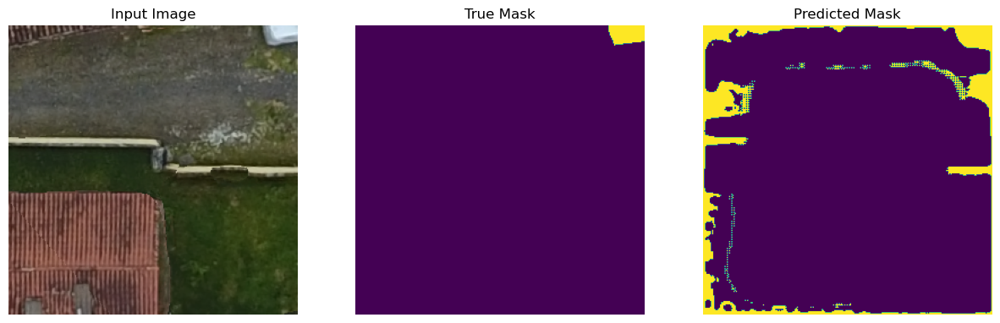

1/1 [==============================] - 0s 39ms/step


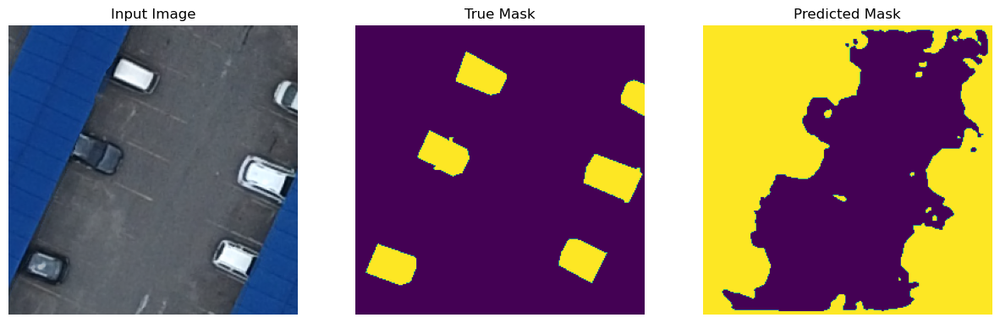

1/1 [==============================] - 0s 34ms/step


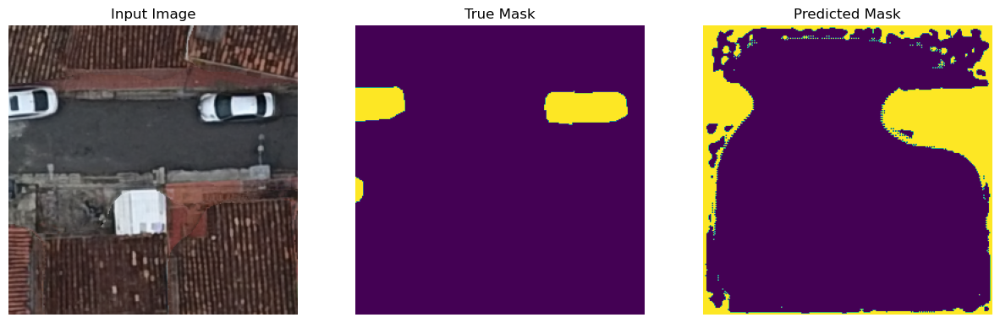

1/1 [==============================] - 0s 38ms/step


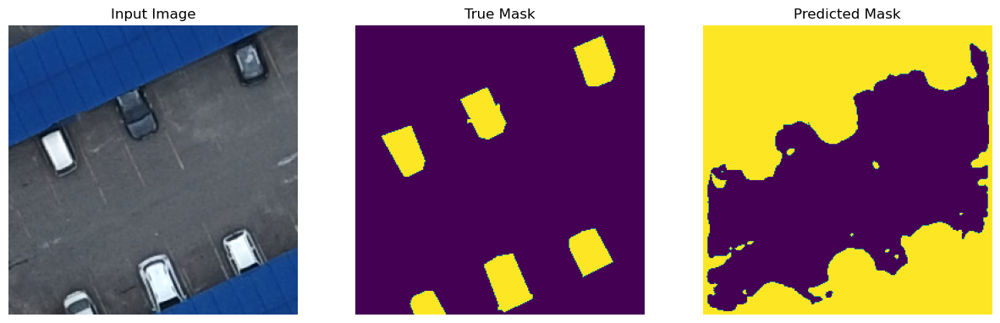

1/1 [==============================] - 0s 39ms/step


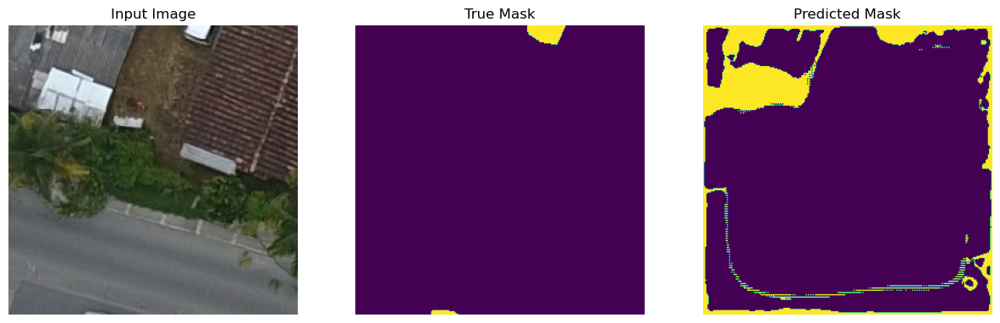

1/1 [==============================] - 0s 32ms/step


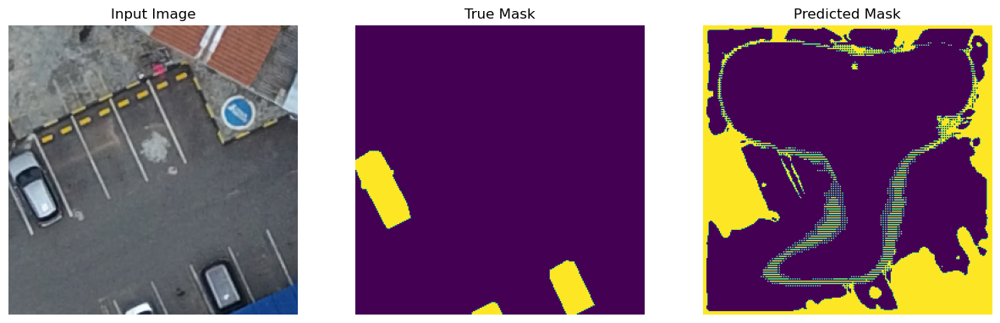

1/1 [==============================] - 0s 34ms/step


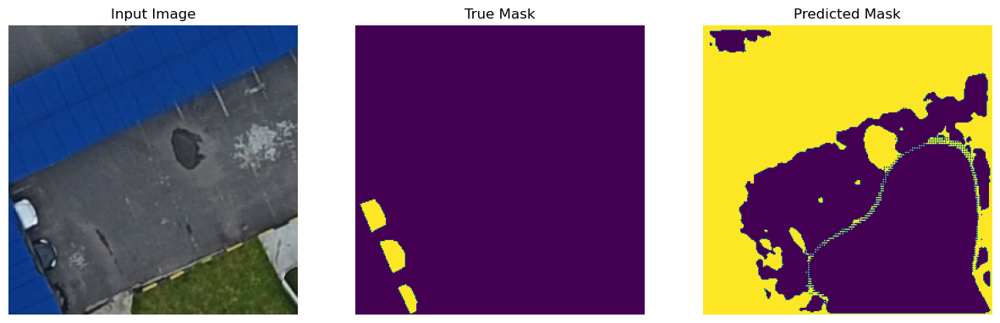

1/1 [==============================] - 0s 34ms/step


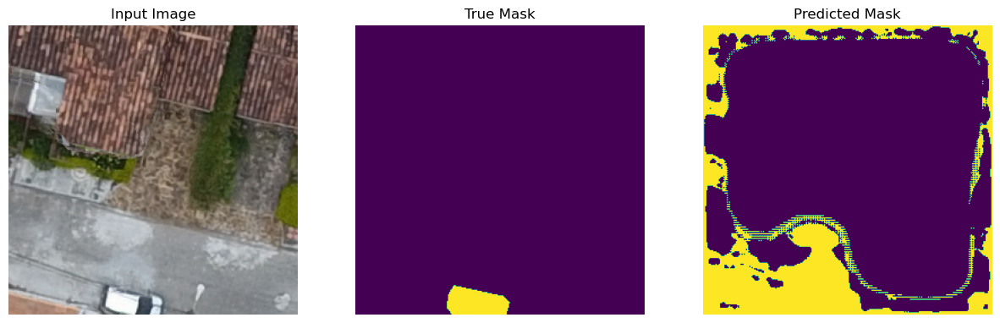

1/1 [==============================] - 0s 35ms/step


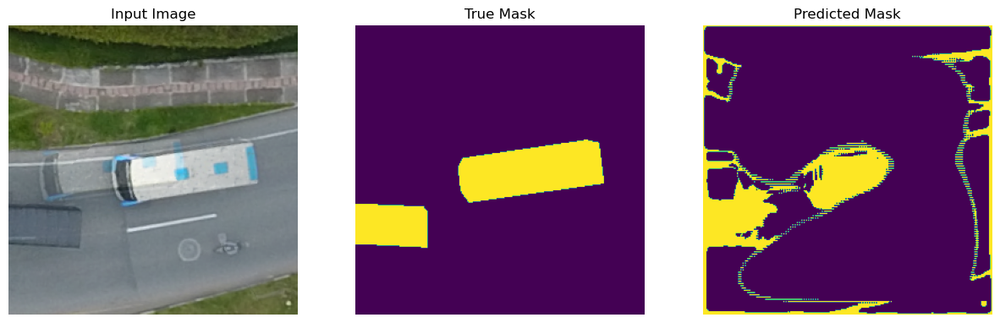

1/1 [==============================] - 0s 43ms/step


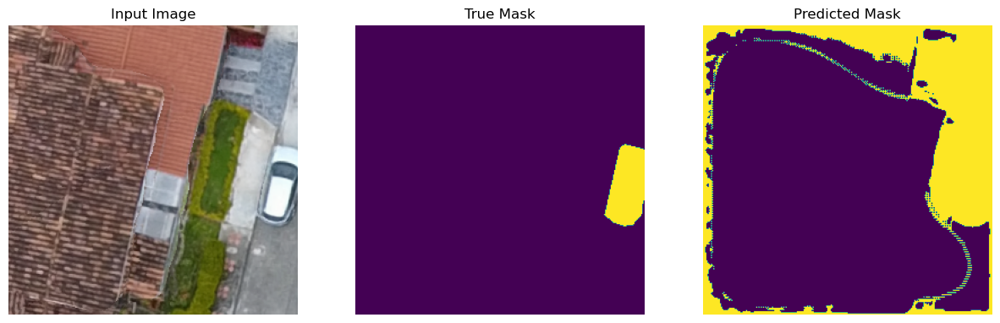

1/1 [==============================] - 0s 42ms/step


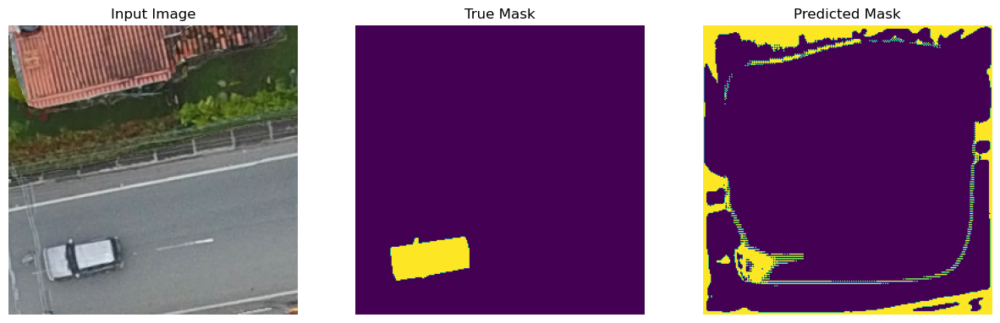

1/1 [==============================] - 0s 36ms/step


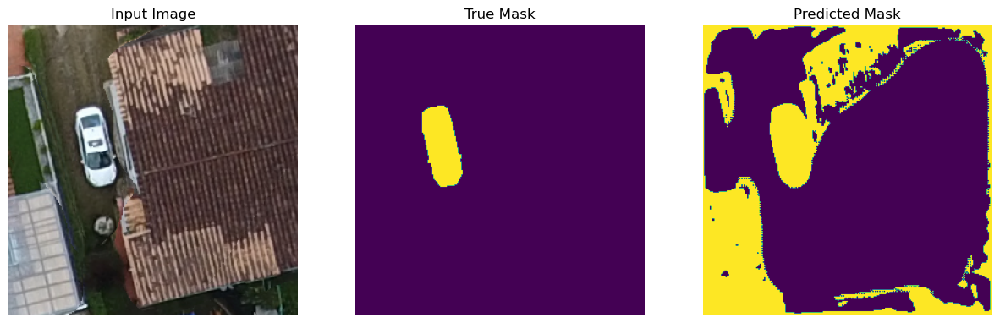

1/1 [==============================] - 0s 34ms/step


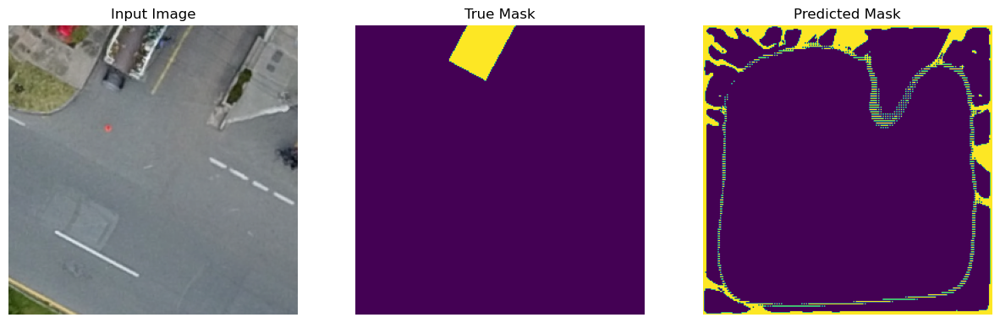

1/1 [==============================] - 0s 46ms/step


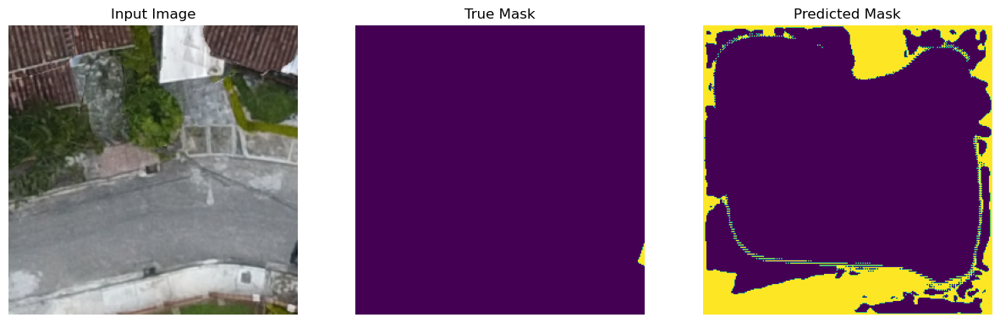

1/1 [==============================] - 0s 35ms/step


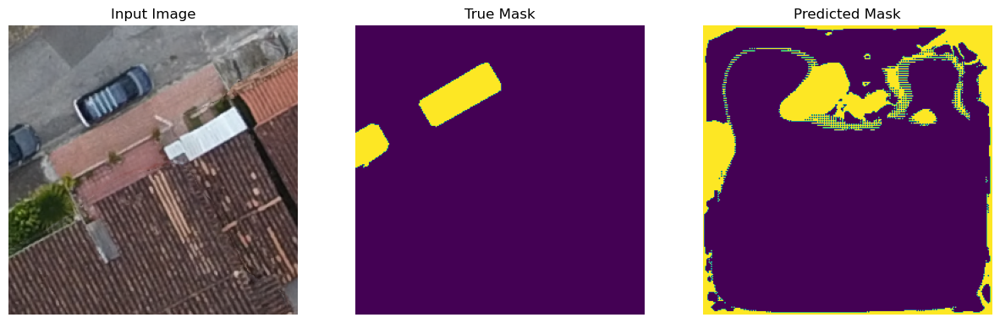

1/1 [==============================] - 0s 24ms/step


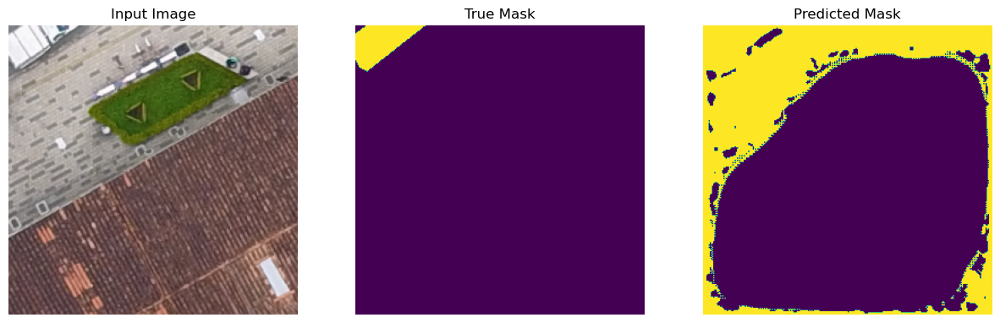

In [35]:
show_predictions(test_batches, model_loaded, 16, 0.05)

1/1 [==============================] - 0s 34ms/step


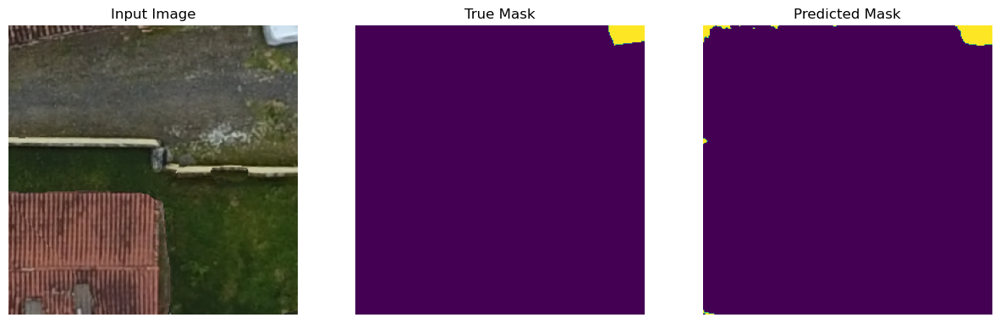

1/1 [==============================] - 0s 33ms/step


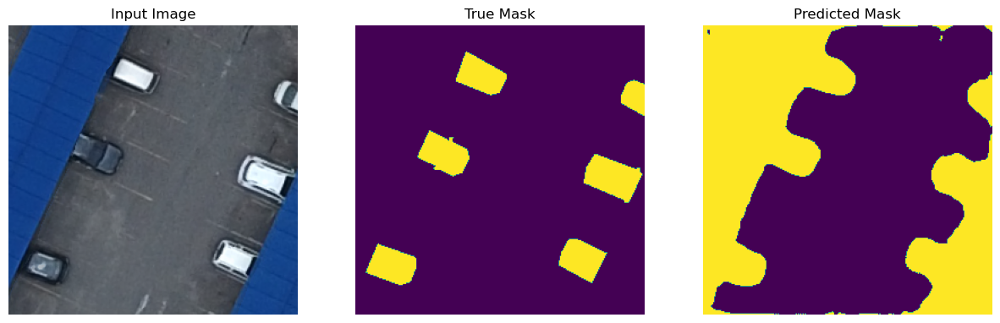

1/1 [==============================] - 0s 32ms/step


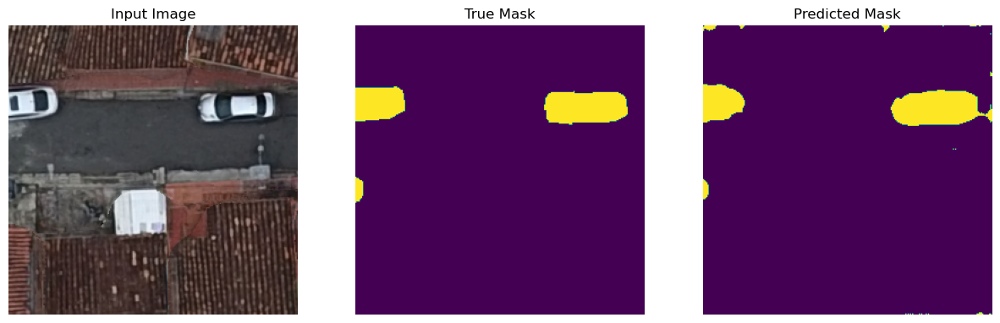

1/1 [==============================] - 0s 33ms/step


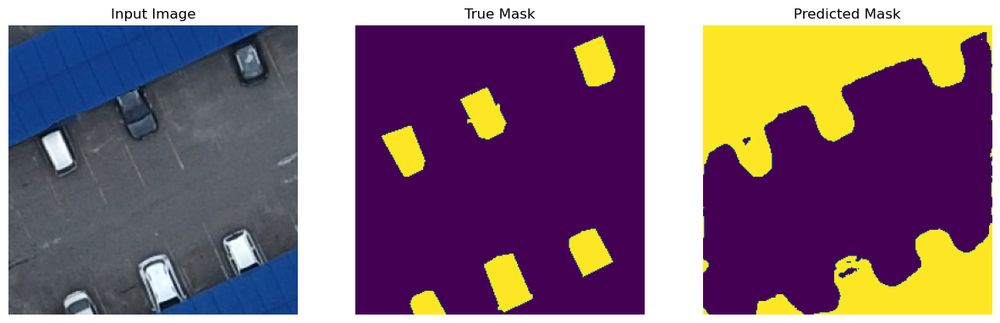

1/1 [==============================] - 0s 31ms/step


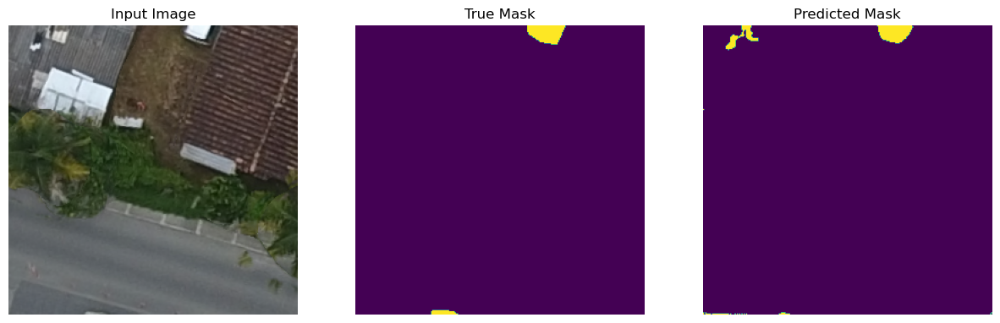

1/1 [==============================] - 0s 32ms/step


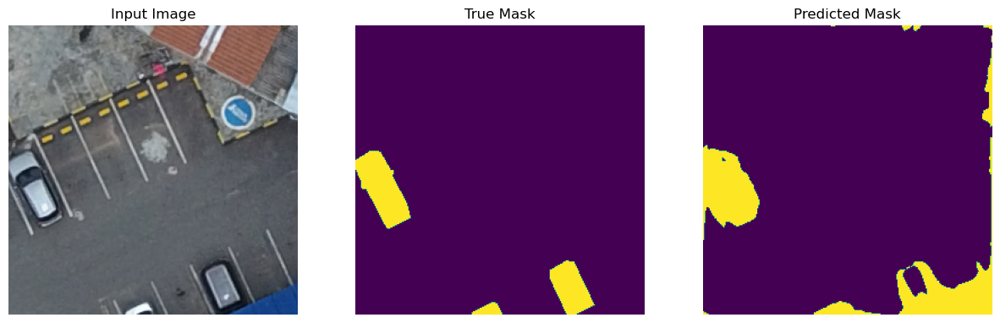

1/1 [==============================] - 0s 34ms/step


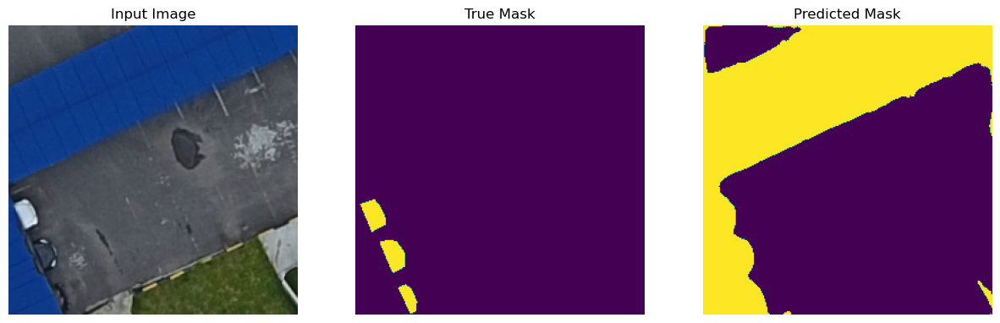

1/1 [==============================] - 0s 32ms/step


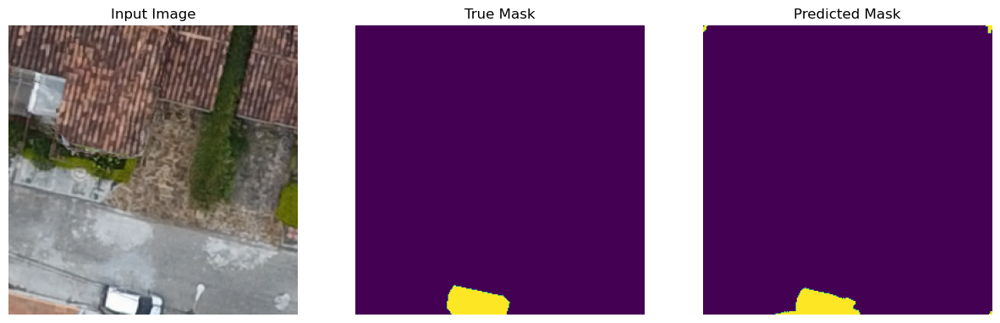

1/1 [==============================] - 0s 50ms/step


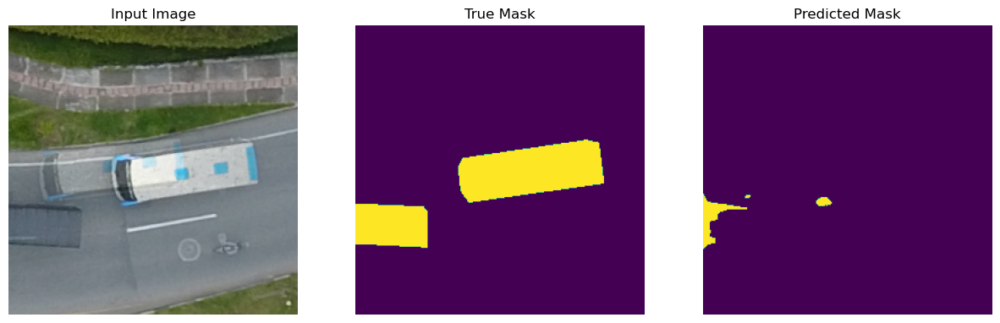

1/1 [==============================] - 0s 35ms/step


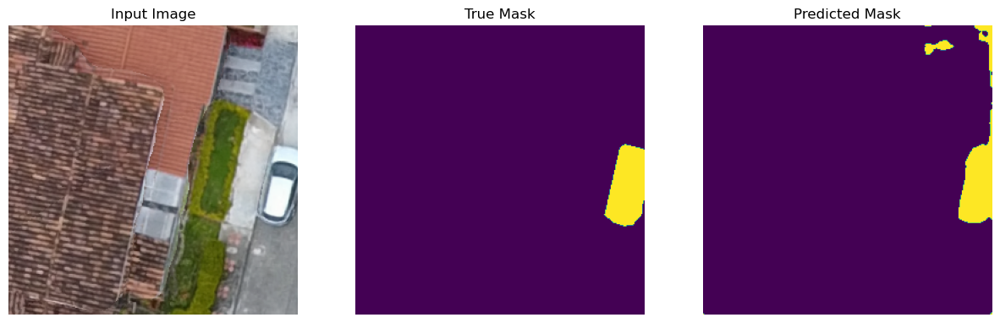

1/1 [==============================] - 0s 30ms/step


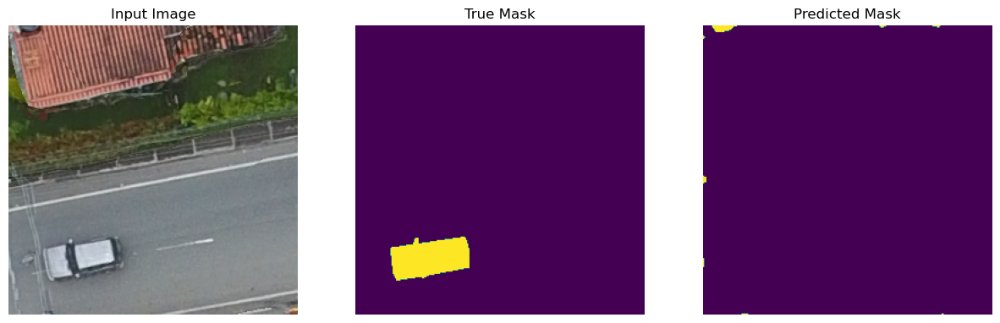

1/1 [==============================] - 0s 32ms/step


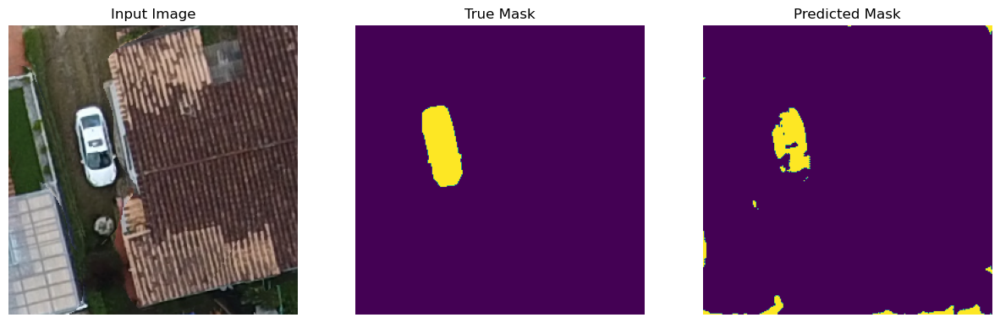

1/1 [==============================] - 0s 32ms/step


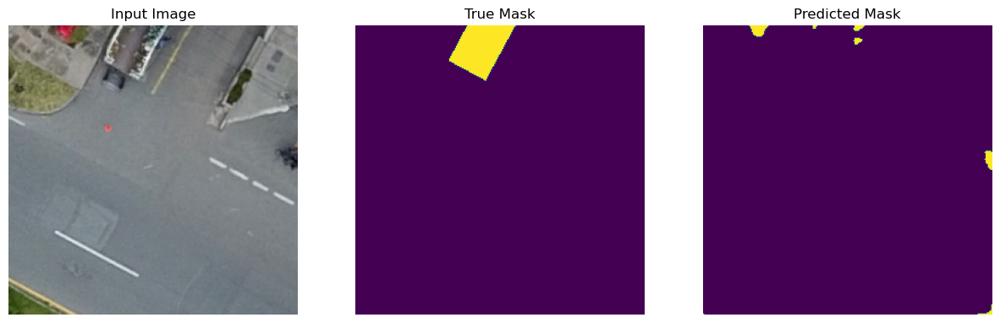

1/1 [==============================] - 0s 31ms/step


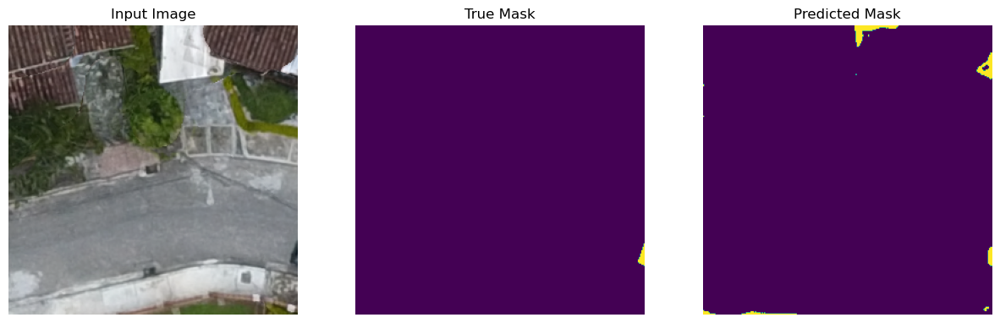

1/1 [==============================] - 0s 121ms/step


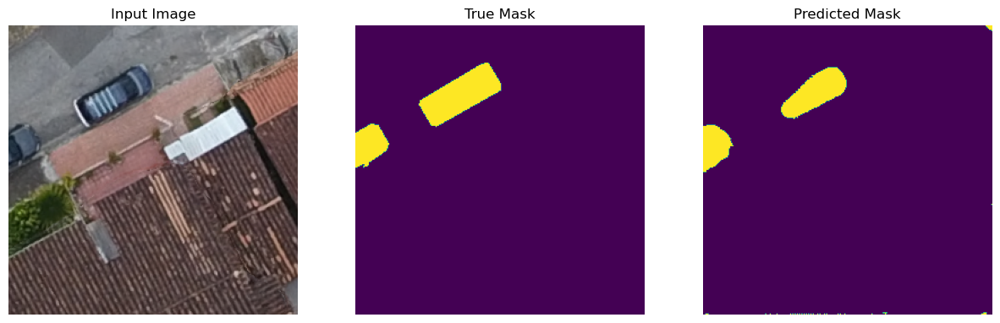

1/1 [==============================] - 0s 39ms/step


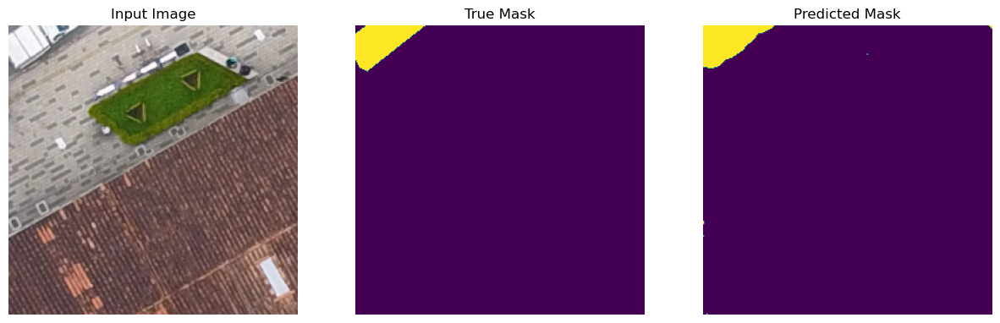

In [29]:
show_predictions(test_batches, model_loaded, 16, 0.1)

1/1 [==============================] - 0s 33ms/step


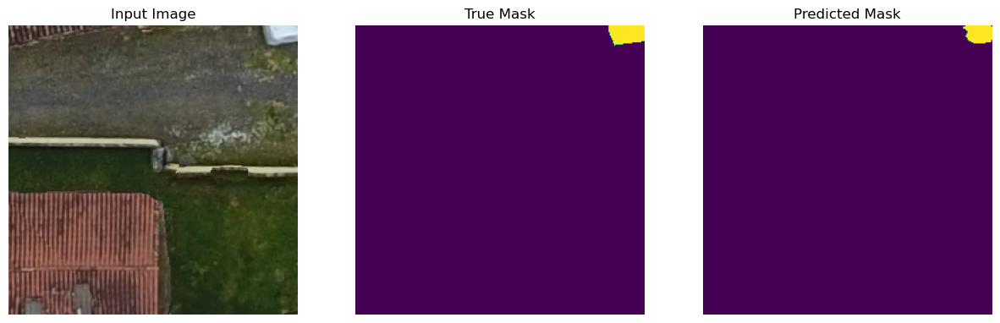

1/1 [==============================] - 0s 33ms/step


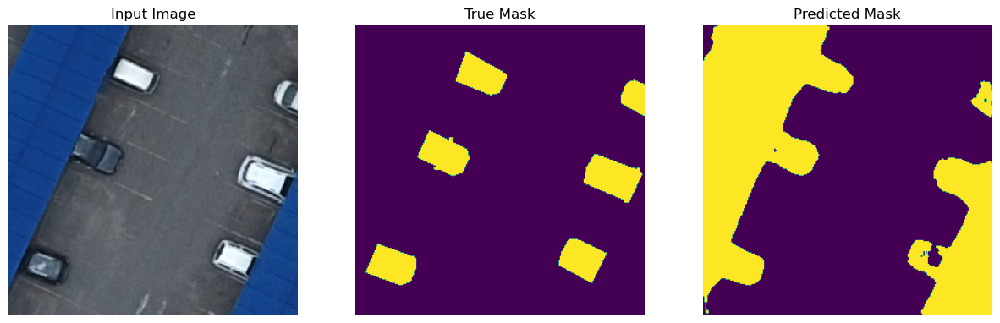

1/1 [==============================] - 0s 34ms/step


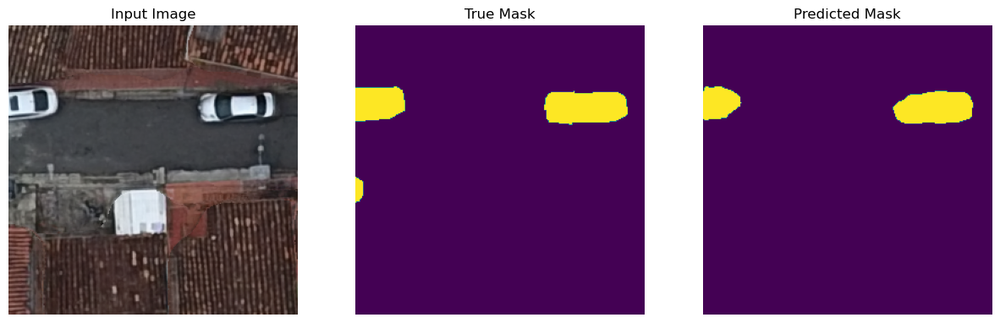

1/1 [==============================] - 0s 31ms/step


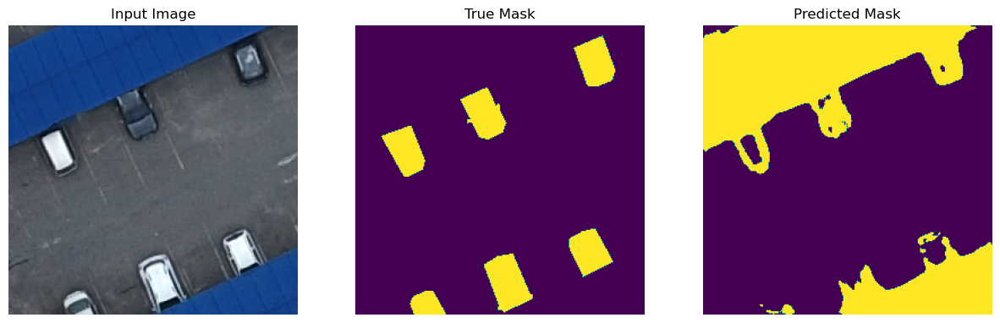

1/1 [==============================] - 0s 43ms/step


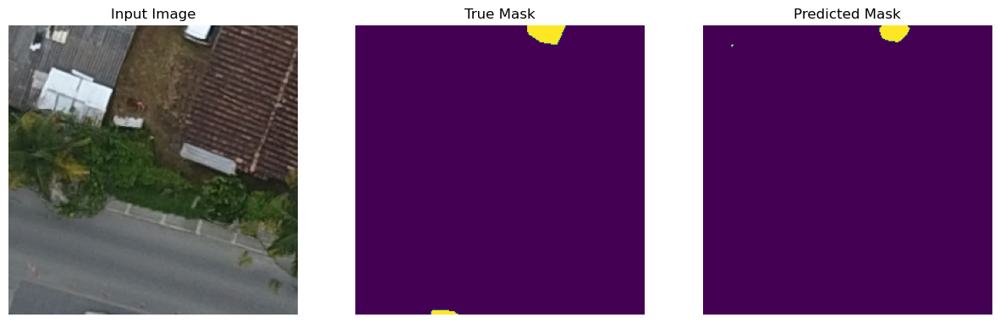

1/1 [==============================] - 0s 32ms/step


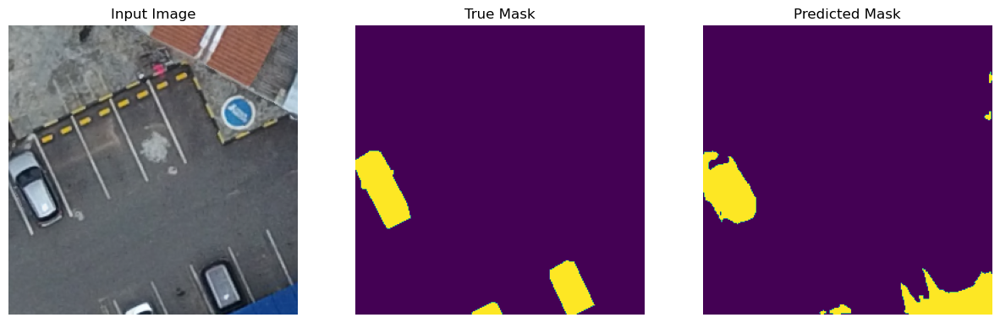

1/1 [==============================] - 0s 40ms/step


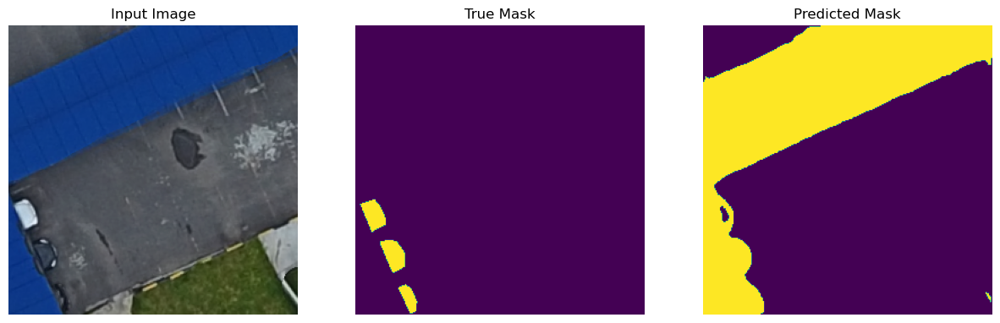

1/1 [==============================] - 0s 55ms/step


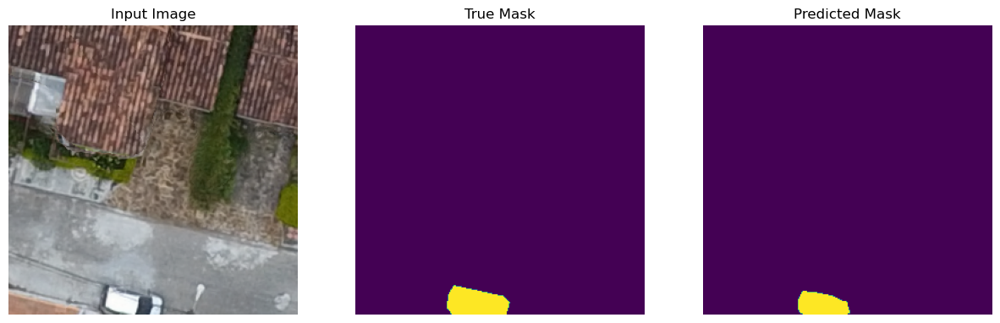

1/1 [==============================] - 0s 42ms/step


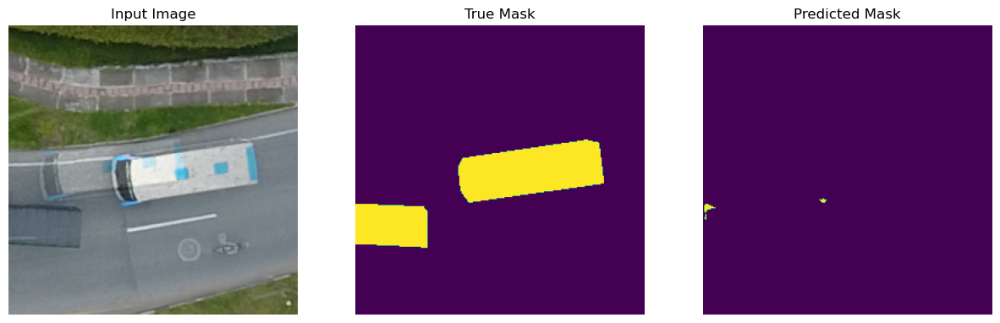

1/1 [==============================] - 0s 35ms/step


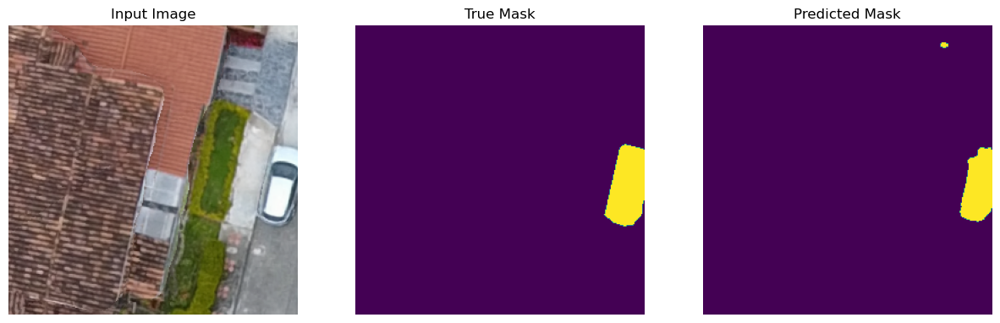

1/1 [==============================] - 0s 31ms/step


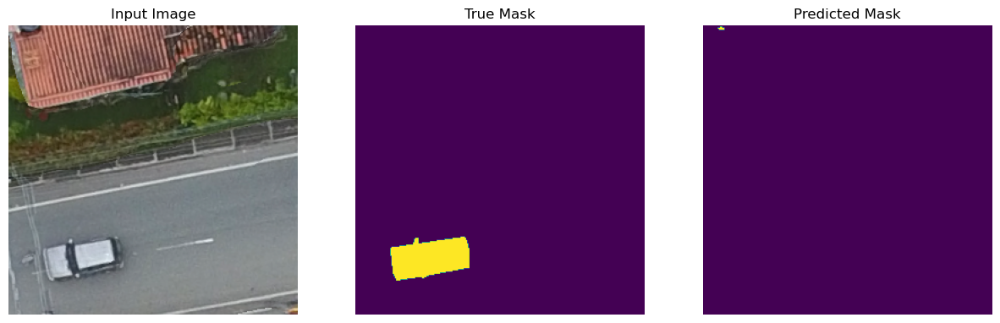

1/1 [==============================] - 0s 34ms/step


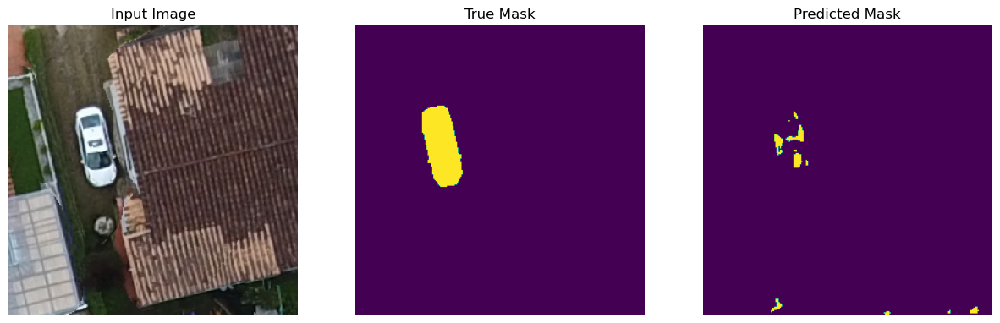

1/1 [==============================] - 0s 31ms/step


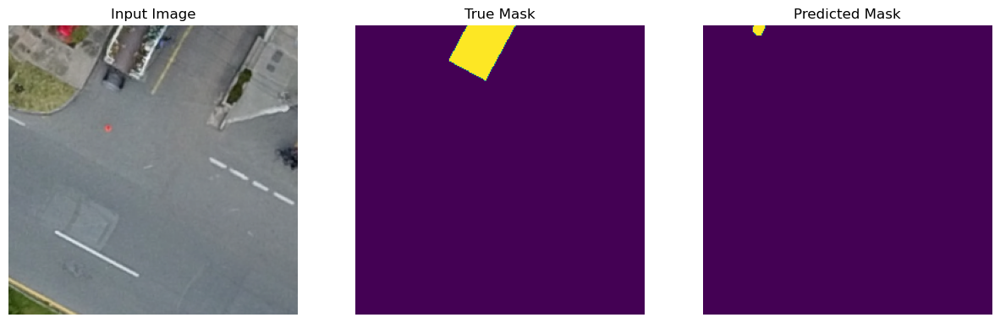

1/1 [==============================] - 0s 34ms/step


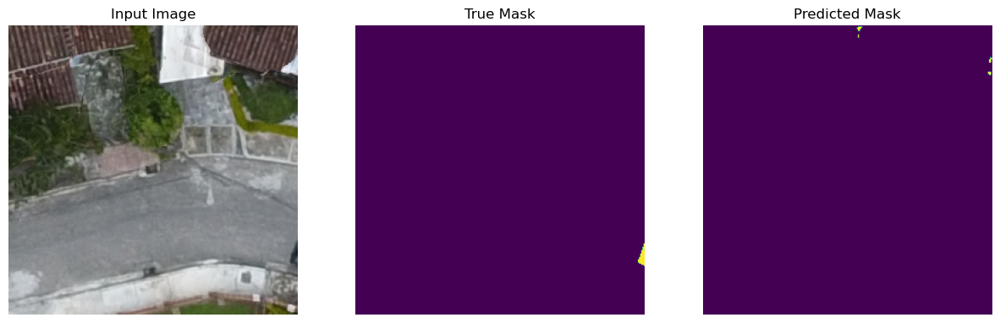

1/1 [==============================] - 0s 31ms/step


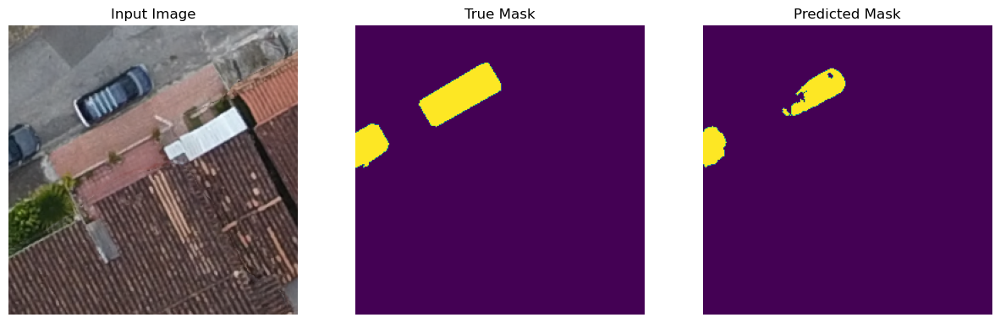

1/1 [==============================] - 0s 25ms/step


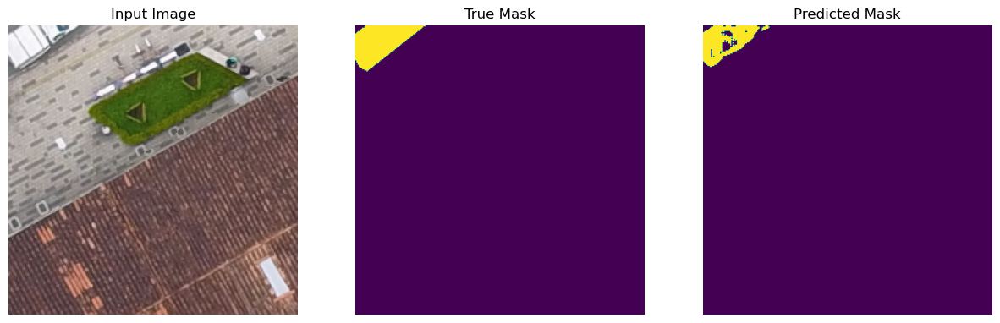

In [30]:
show_predictions(test_batches, model_loaded, 16, 0.15)

1/1 [==============================] - 0s 33ms/step


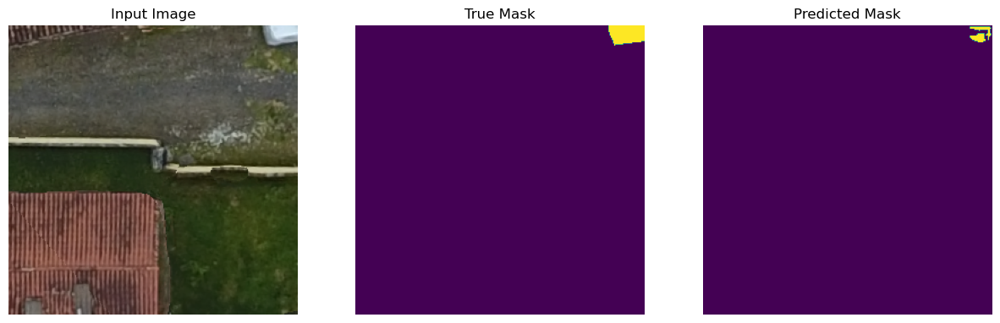

1/1 [==============================] - 0s 49ms/step


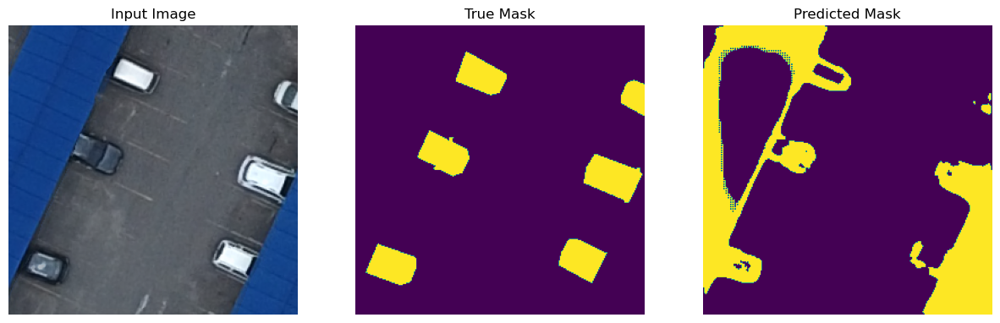

1/1 [==============================] - 0s 36ms/step


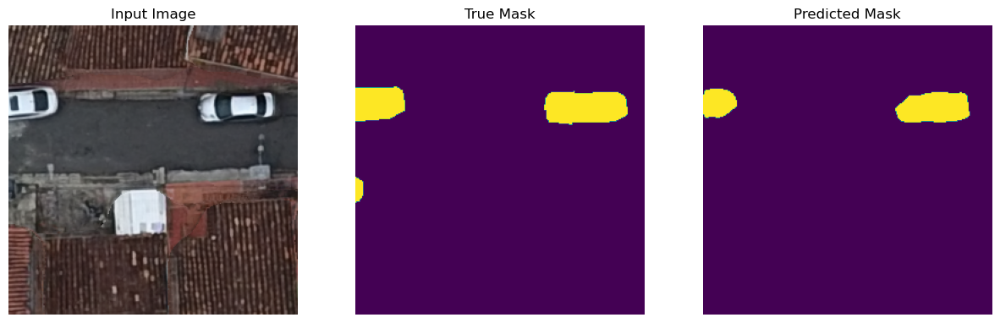

1/1 [==============================] - 0s 38ms/step


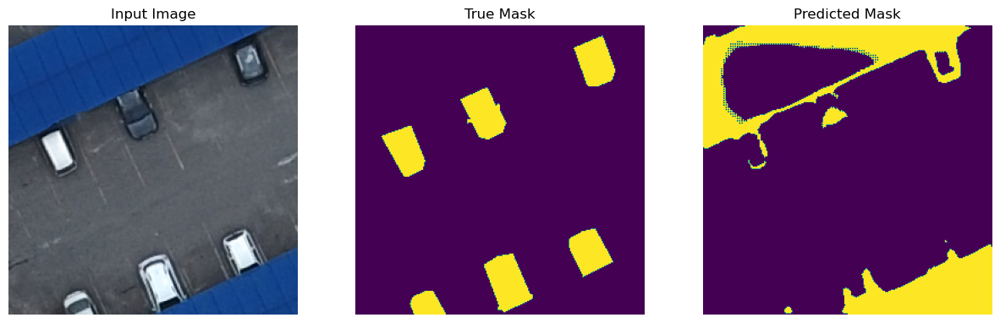

1/1 [==============================] - 0s 34ms/step


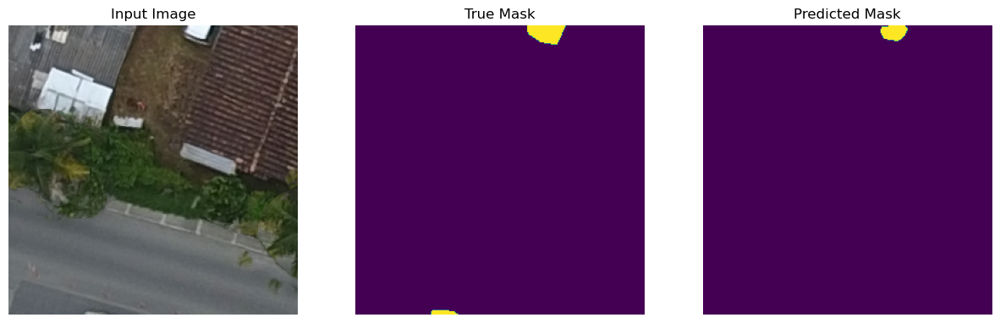

1/1 [==============================] - 0s 36ms/step


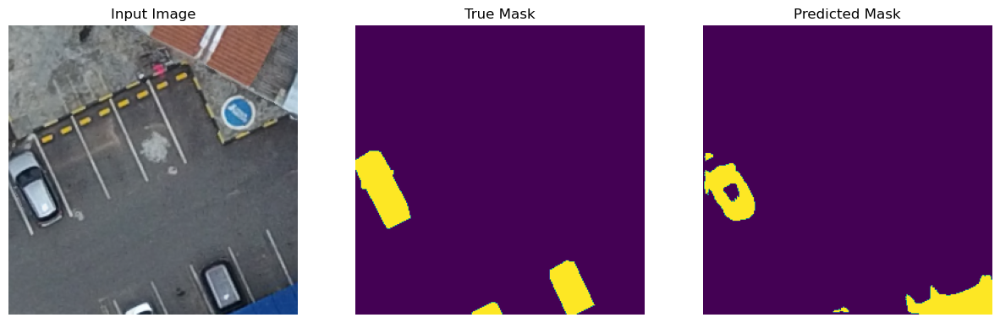

1/1 [==============================] - 0s 35ms/step


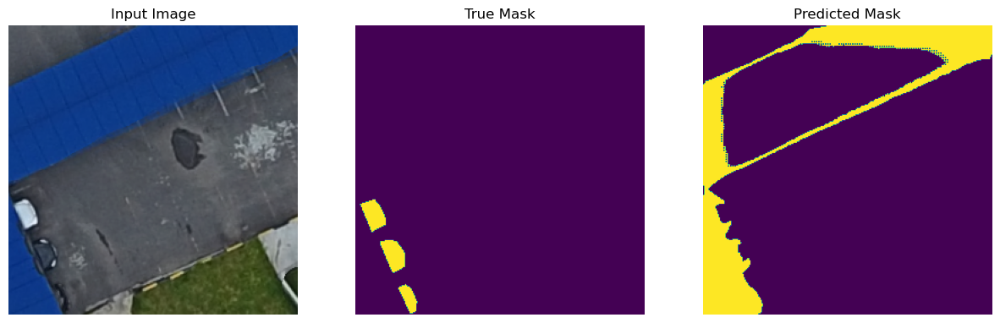

1/1 [==============================] - 0s 36ms/step


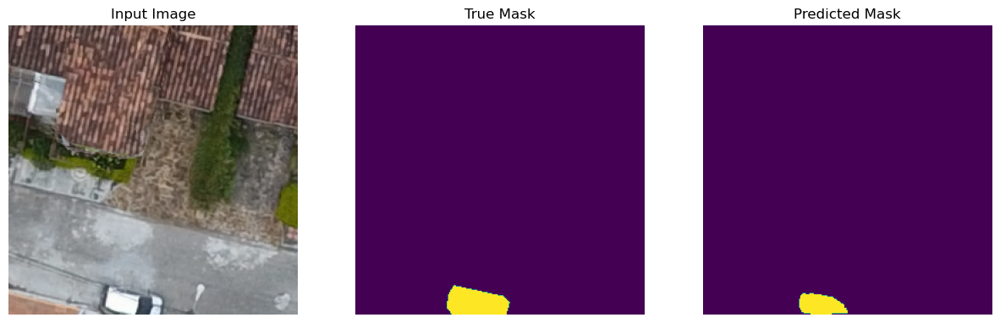

1/1 [==============================] - 0s 35ms/step


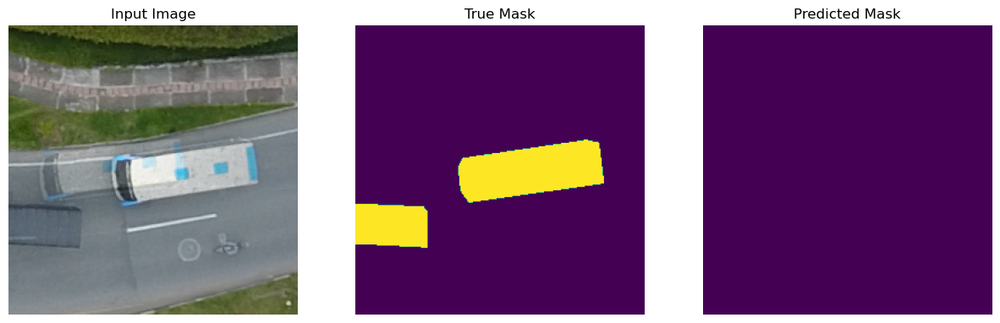

1/1 [==============================] - 0s 34ms/step


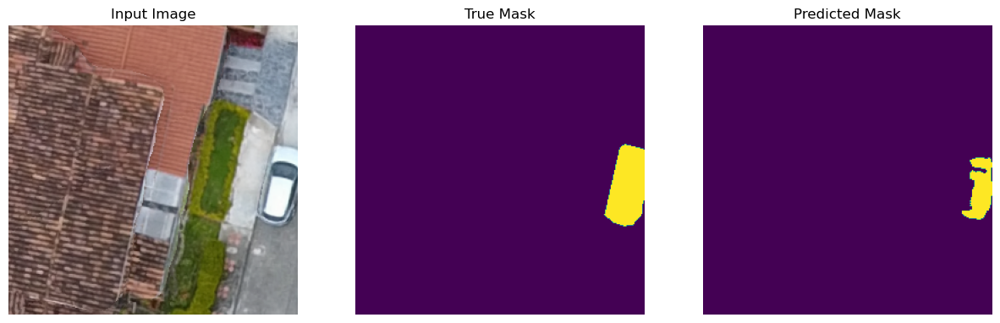

1/1 [==============================] - 0s 42ms/step


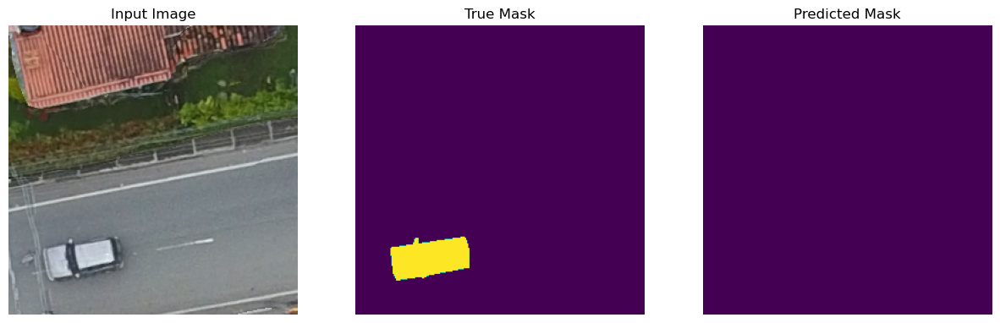

1/1 [==============================] - 0s 32ms/step


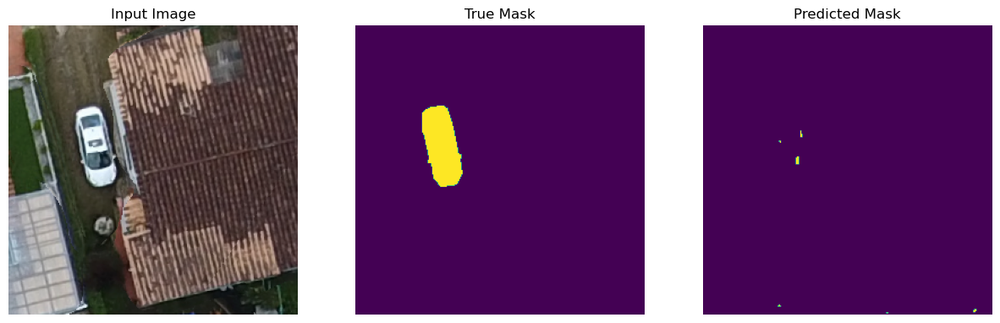

1/1 [==============================] - 0s 48ms/step


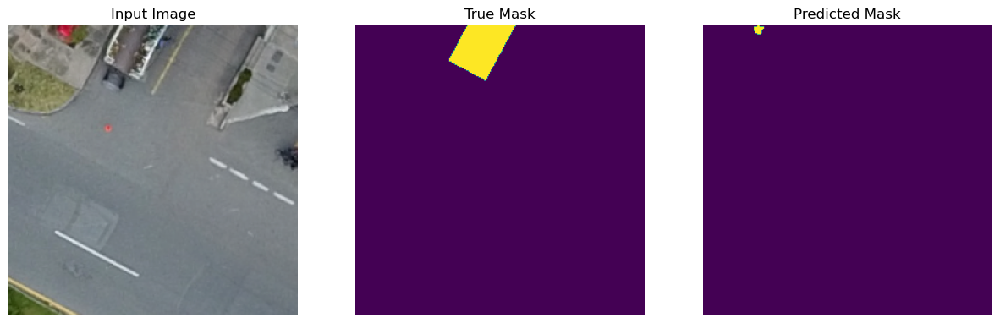

1/1 [==============================] - 0s 36ms/step


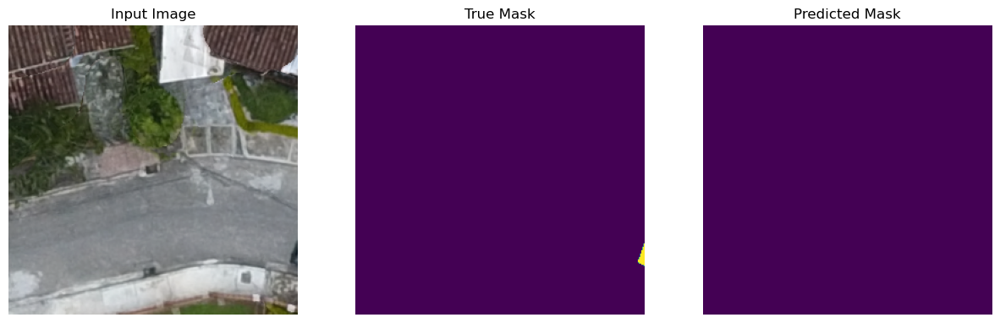

1/1 [==============================] - 0s 40ms/step


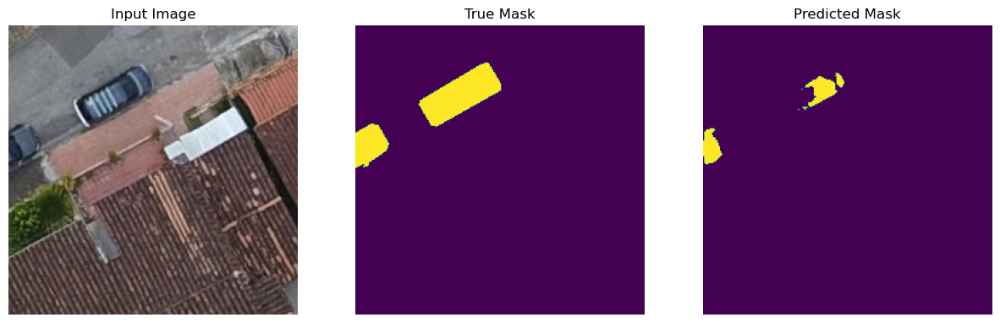

1/1 [==============================] - 0s 24ms/step


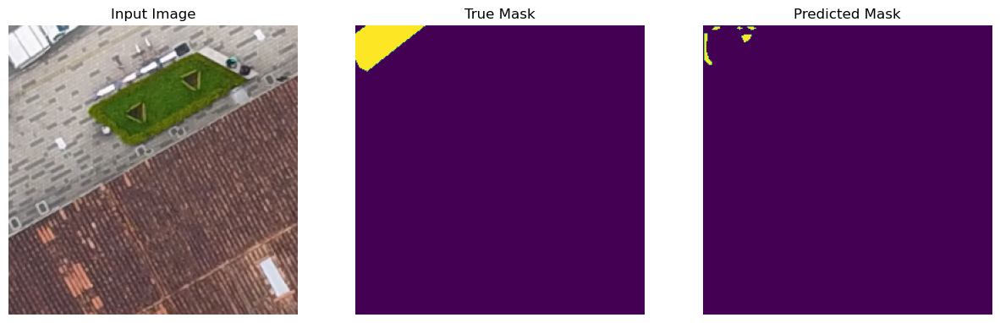

In [31]:
show_predictions(test_batches,model_loaded, 16, 0.2)

1/1 [==============================] - 0s 33ms/step


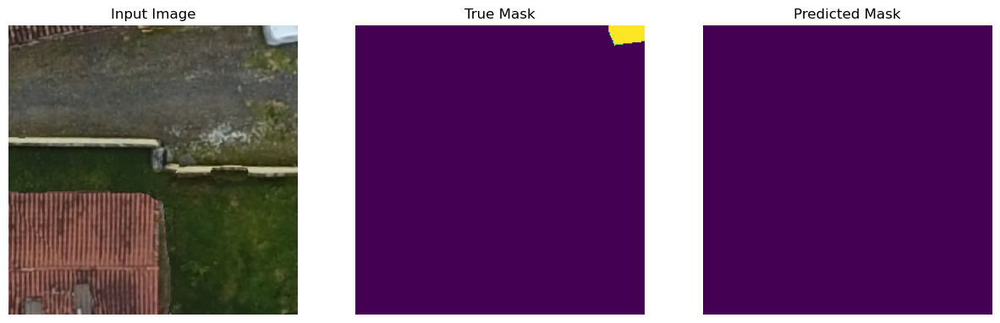

1/1 [==============================] - 0s 39ms/step


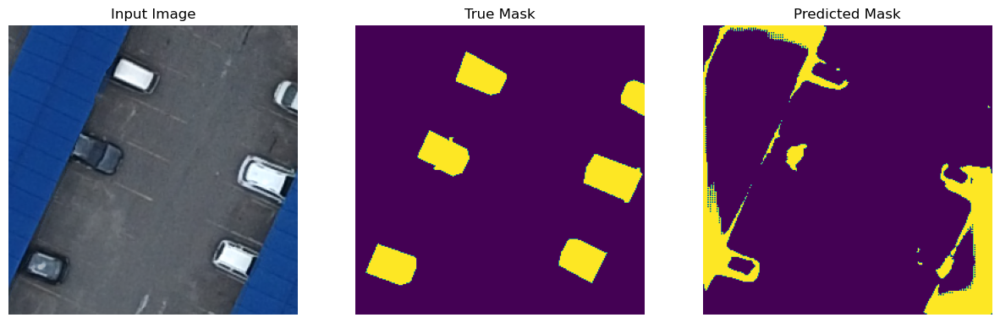

1/1 [==============================] - 0s 32ms/step


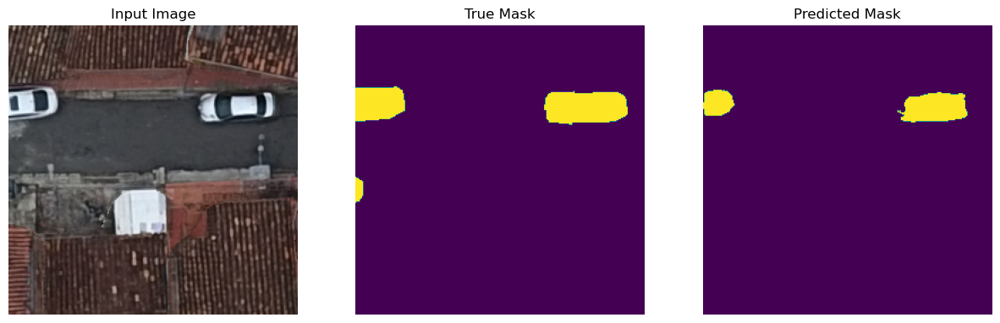

1/1 [==============================] - 0s 32ms/step


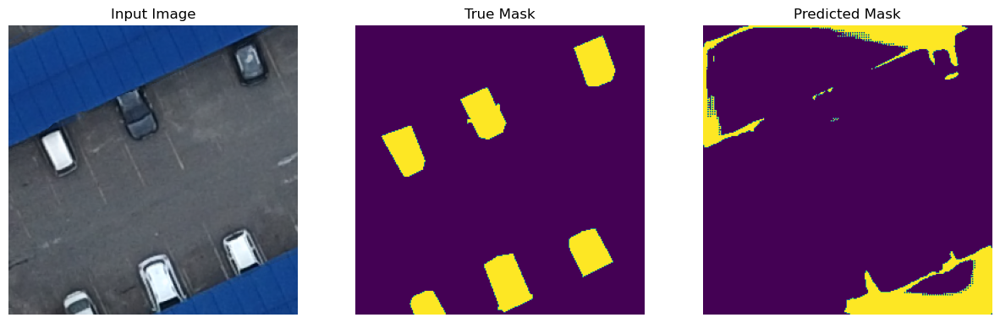

1/1 [==============================] - 0s 33ms/step


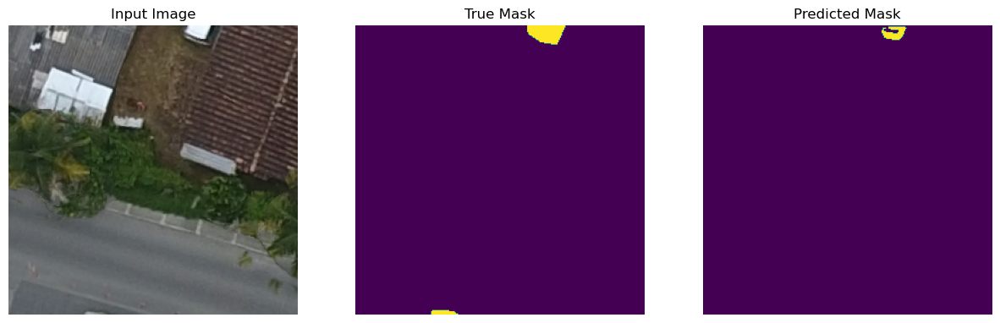

1/1 [==============================] - 0s 38ms/step


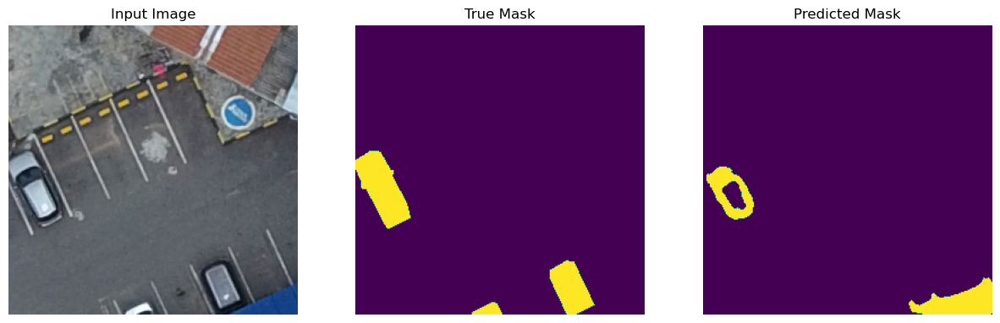

1/1 [==============================] - 0s 54ms/step


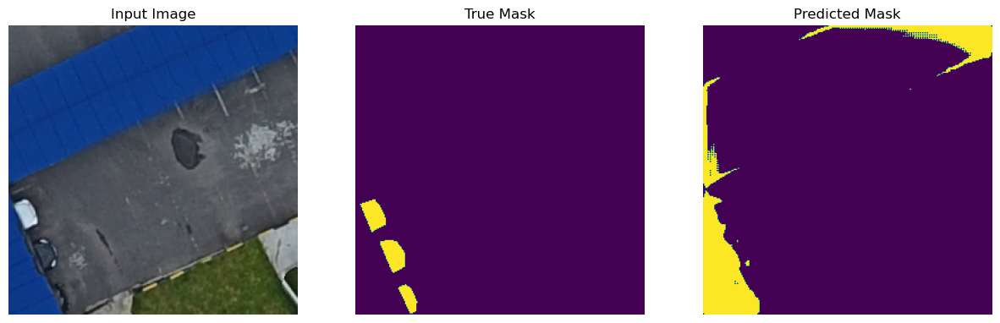

1/1 [==============================] - 0s 31ms/step


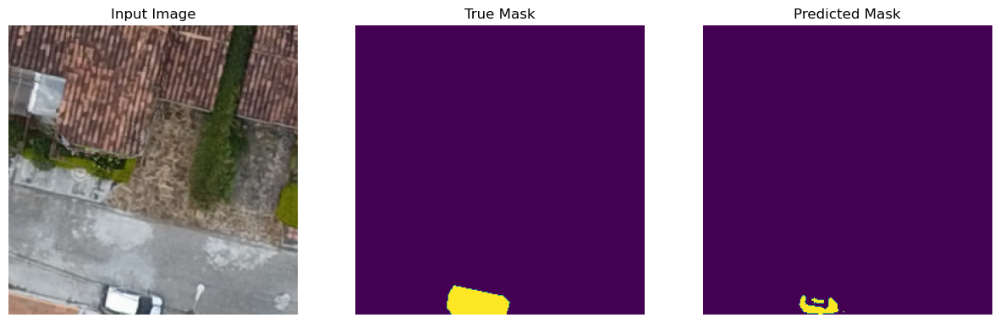

1/1 [==============================] - 0s 36ms/step


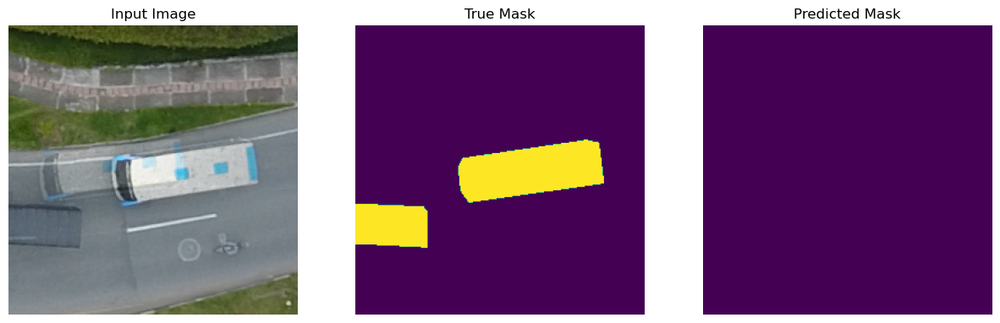

1/1 [==============================] - 0s 35ms/step


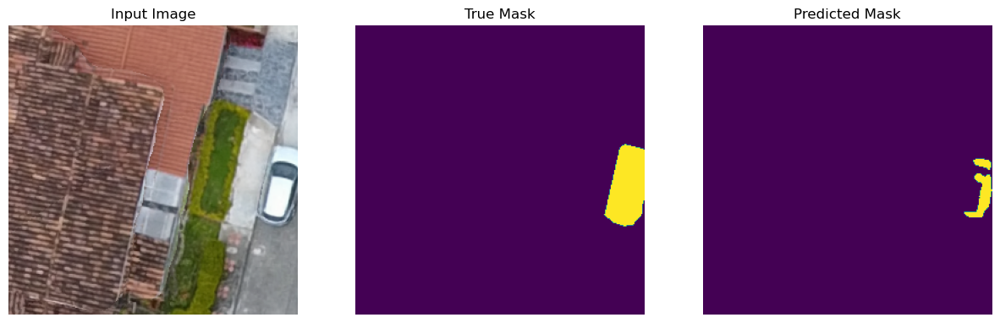

1/1 [==============================] - 0s 34ms/step


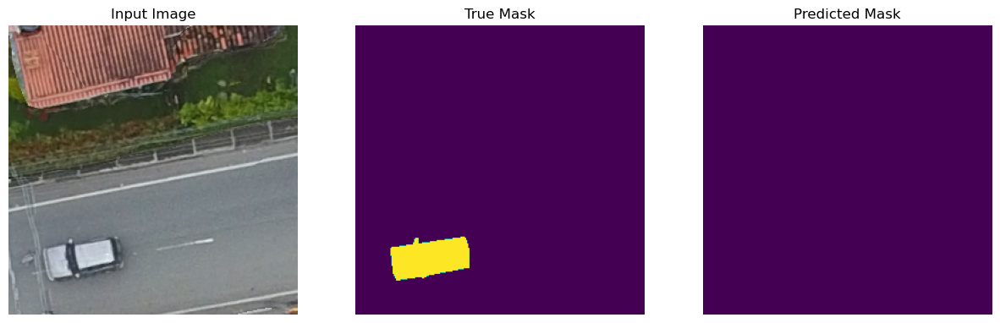

1/1 [==============================] - 0s 35ms/step


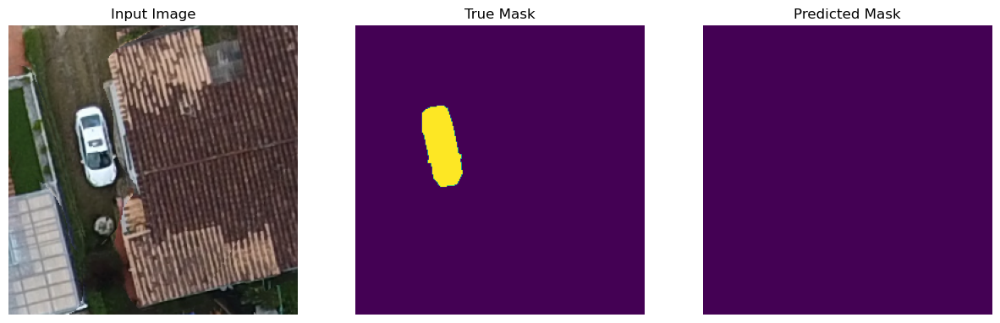

1/1 [==============================] - 0s 33ms/step


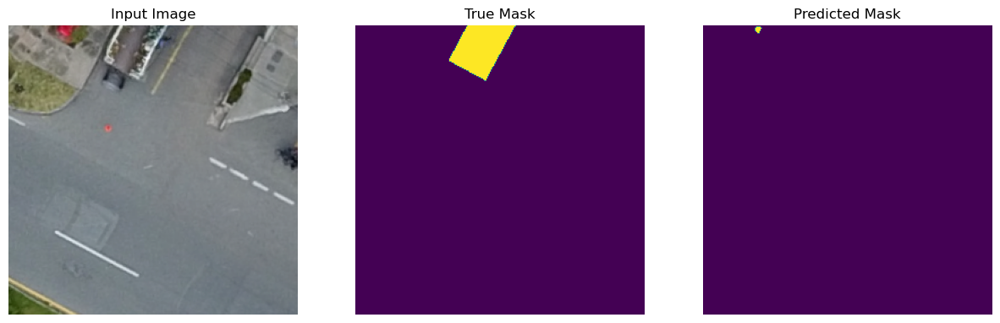

1/1 [==============================] - 0s 48ms/step


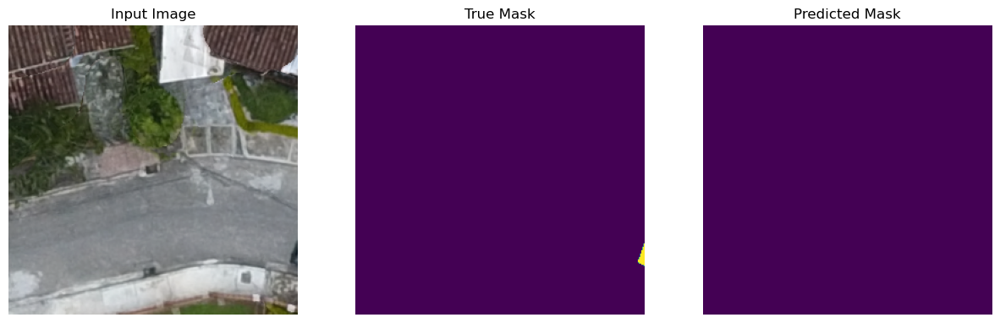

1/1 [==============================] - 0s 35ms/step


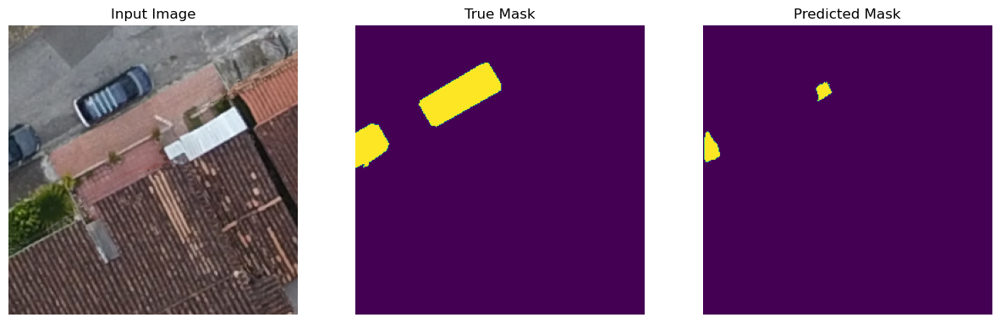

1/1 [==============================] - 0s 23ms/step


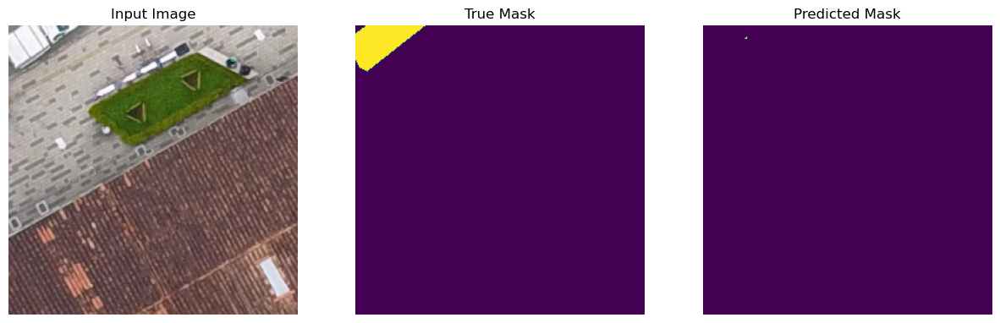

In [32]:
show_predictions(test_batches, model_loaded, 16, 0.25)